### To begin, we import the necessary Python packages

In [1]:
import json
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib import gridspec as mpgs
import numpy as np
import scipy as sp
import matplotlib as mpl
from skimage import transform as skt
import os
import time
import multiprocessing as mp
import skimage.filters as skf
from scipy import ndimage as scnd
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib_scalebar.scalebar import SI_LENGTH_RECIPROCAL
from matplotlib.offsetbox import AnchoredText
import math
import sys
import numba
import pyfftw
import pymcr
%matplotlib inline
plt.rcParams['image.cmap'] = 'magma'
plt.rcParams.update({'font.size': 25})
plt.rcParams.update({'font.weight': 'bold'})
plt.rcParams.update({'figure.autolayout': True})

In [2]:
import sys
sys.path.append('/home/cades/Codes/stemtools')
import stemtools as st
%load_ext autoreload
%autoreload 2

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
from matplotlib.colors import LinearSegmentedColormap as LSC
vl_cl = LSC.from_list('list', [(0, 0, 0), (0.557,0.267, 0.678),(1,1,1)], N=256)
bu_cl = LSC.from_list('list', [(0, 0, 0), (0.161,0.502, 0.725),(1,1,1)], N=256)
gr_cl = LSC.from_list('list', [(0, 0, 0), (0.153,0.682, 0.376),(1,1,1)], N=256)
yl_cl = LSC.from_list('list', [(0, 0, 0), (0.945,0.769, 0.059),(1,1,1)], N=256)
or_cl = LSC.from_list('list', [(0, 0, 0), (0.902,0.494, 0.133),(1,1,1)], N=256)
rd_cl = LSC.from_list('list', [(0, 0, 0), (0.906,0.298, 0.235),(1,1,1)], N=256)
lin_burd = LSC.from_list('list', [(0, 35/255, 156/255), (0.95,0.95, 0.95),(249/255,56/255,34/255)], N=256)

In [5]:
dir_path = "/home/cades/Data4D_2/Debangshu/Core@Shell NBED/Nion Swift Library 20190810 - EH-83-I Rh@Pt Thick/"

Then we go to the folder where our data is stored, and load the 4D data

In [6]:
retval = os.getcwd()
os.chdir(dir_path)

In [7]:
st.tic()
strain4D = np.load('Particle1_4DSTEM.npy')
json4D = 'Particle1_4DSTEM.json'
simulADF = np.load('Particle1_4DSTEM_ADF.npy')
jsonADF = 'Particle1_4DSTEM_ADF.json'
with open(json4D) as json_4D:
    info4D = json.load(json_4D)
with open(jsonADF) as json_ADF:
    infoADF = json.load(json_ADF)
st.toc()

Elapsed time: 8.336541 seconds.



In [8]:
strain4D = np.transpose(strain4D,(2,3,0,1))

To do the calculations it is significantly easier to transpose the datasets. Normally both NION and Titan generates data in the format of [ScanY,ScanX,DiffQ,DiffP] where Scan refers to the real dimensions and Diff refers to the Fourier dimensions and [P,Q] are the Fourier coordinates of [X,Y]. However, we transpose our data to be of the form [DiffQ,DiffP,ScanY,ScanX]

In [9]:
strain4D.shape

(360, 360, 200, 200)

In [10]:
scan_calib_vals = infoADF['spatial_calibrations'][0]['scale']
scan_calib_unit = infoADF['spatial_calibrations'][0]['units']

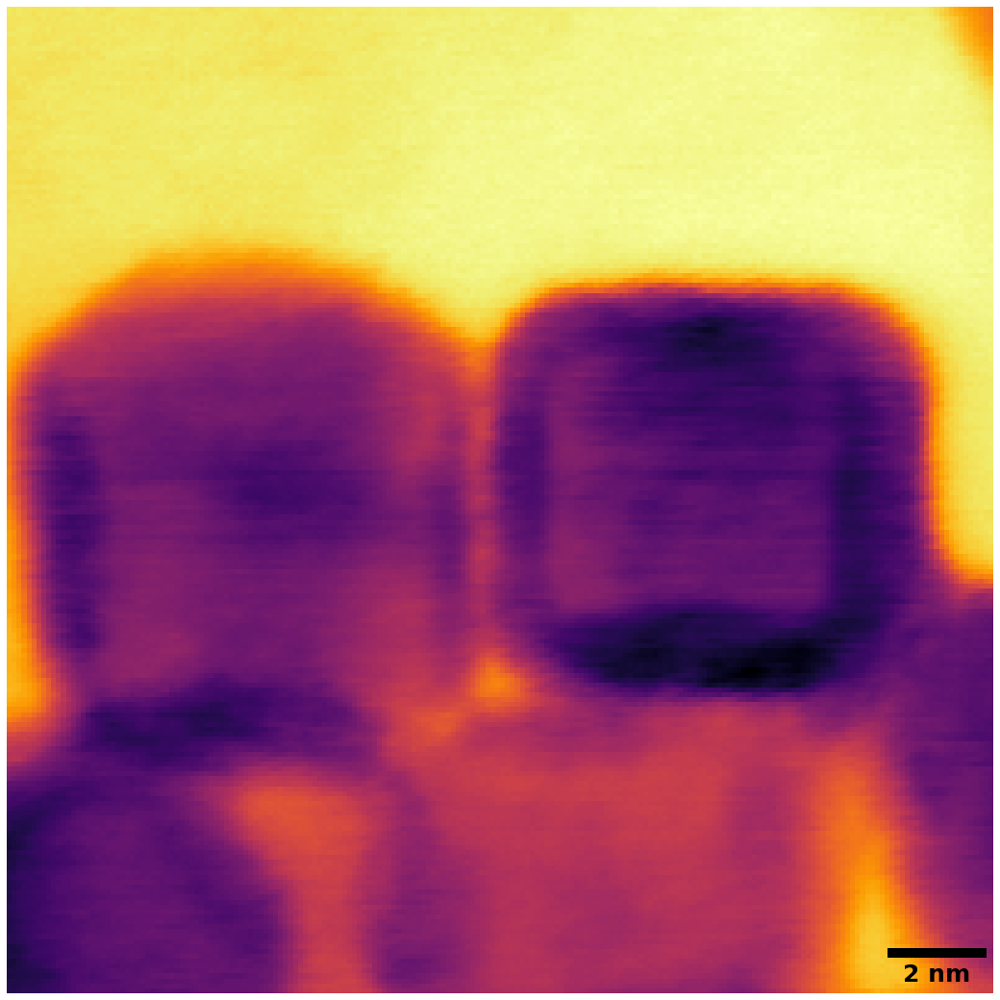

In [11]:
bf_stem = np.sum(strain4D,axis=(0,1))
plt.figure(figsize=(15,15))
plt.imshow(bf_stem,cmap='inferno')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.tight_layout()

In [12]:
%timeit st.nbed.bin4D(strain4D[:,:,0:20,0:20],4)

921 ms ± 3.59 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [13]:
st.tic()
binned_strain4D = st.nbed.bin4D(strain4D,4)
st.toc()

Elapsed time: 53.371079 seconds.



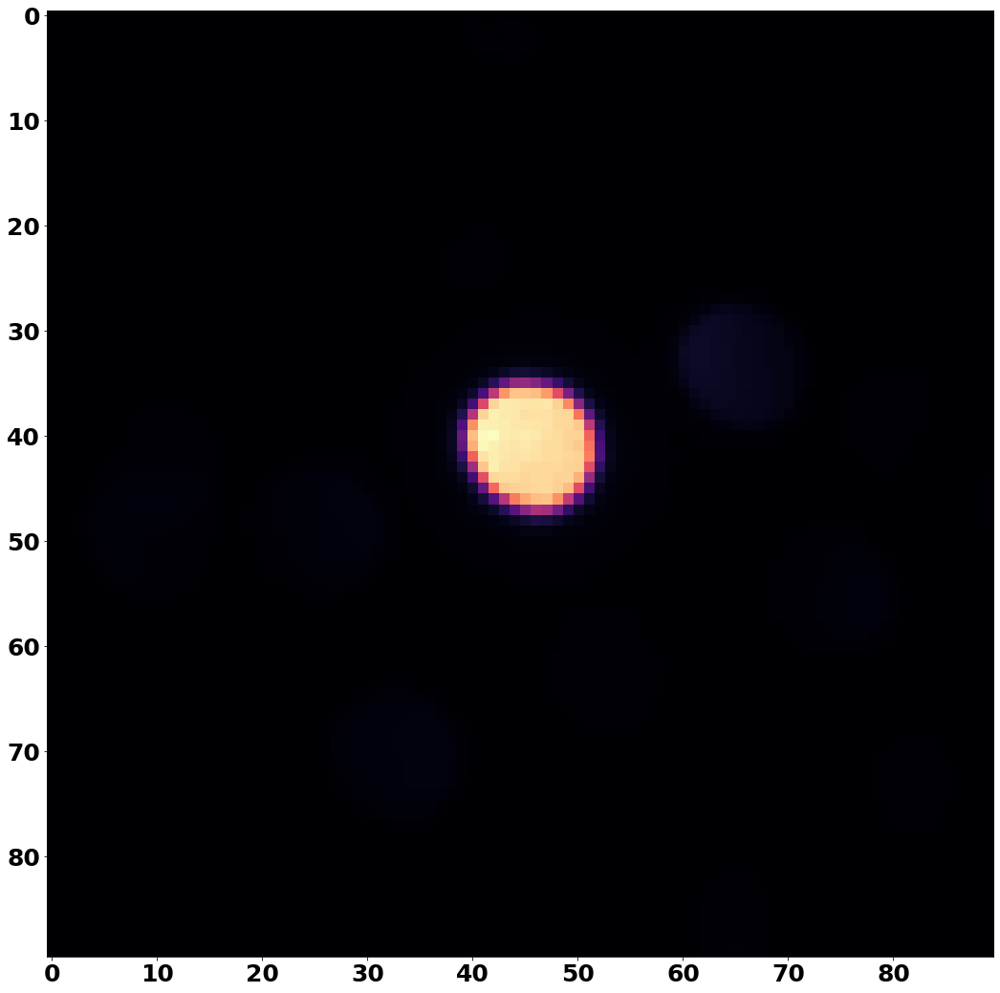

In [14]:
mean_binned_cbed = np.mean(binned_strain4D,axis=(2,3),dtype=np.float64)
plt.figure(figsize=(15,15))
plt.imshow(mean_binned_cbed)

In [15]:
st.tic()
strain4D_2col = (st.nbed.data4Dto2D(binned_strain4D)).astype(np.float64)
st.toc()

Elapsed time: 0.882210 seconds.



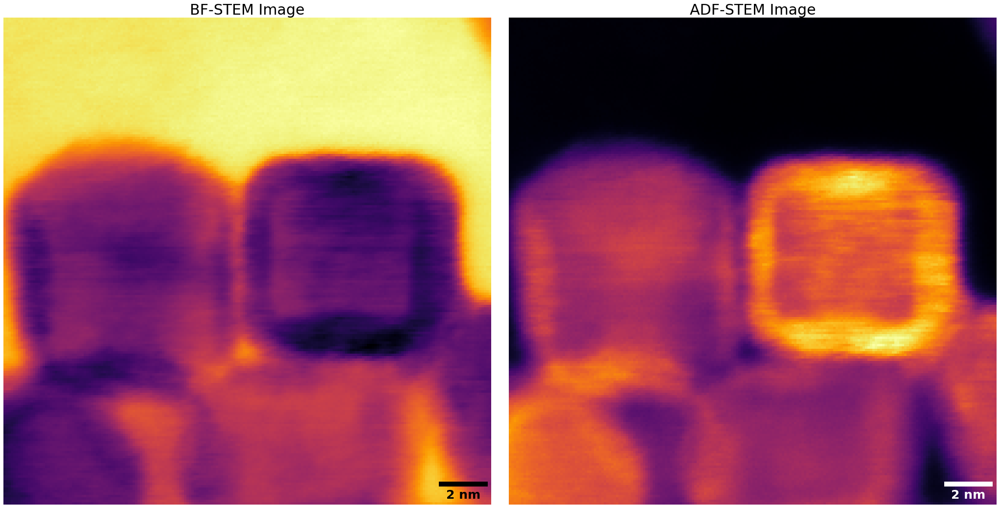

In [16]:
plt.figure(figsize=(30, 15))
plt.subplot(1,2,1)
plt.imshow(bf_stem,cmap='inferno')
plt.title('BF-STEM Image')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
plt.axis('off')

plt.subplot(1,2,2)
plt.imshow(simulADF,cmap='inferno')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'w'
plt.gca().add_artist(scalebar)
plt.axis('off')
plt.title('ADF-STEM Image')

plt.tight_layout()
plt.savefig('Results_4D/Particle1_BF_ADF.pdf')

In [ ]:
st.tic()
amorphous_r,amorphous_r_im = st.nbed.spectra_finder(binned_strain4D,(0,25),(0,150))
side_part_1,side_part_1_im = st.nbed.spectra_finder(binned_strain4D,(75,125),(25,75))
side_part_2,side_part_2_im = st.nbed.spectra_finder(binned_strain4D,(175,-1),(0,25))
side_part_3,side_part_3_im = st.nbed.spectra_finder(binned_strain4D,(175,-1),(65,75))
side_part_4,side_part_4_im = st.nbed.spectra_finder(binned_strain4D,(175,-1),(100,140))
side_part_5,side_part_5_im = st.nbed.spectra_finder(binned_strain4D,(150,180),(190,-1))
main_part_c,main_part_c_im = st.nbed.spectra_finder(binned_strain4D,(85,105),(130,155))
main_part_s,main_part_s_im = st.nbed.spectra_finder(binned_strain4D,(128,135),(130,155))
st.toc()

font_size = int(16)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

plt.figure(figsize=(20,10))

plt.subplot(2,4,1)
plt.imshow(amorphous_r_im,cmap='Spectral_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Amorphous Region',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(2,4,2)
plt.imshow(side_part_1_im,cmap='Spectral_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 1',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(2,4,3)
plt.imshow(side_part_2_im,cmap='Spectral_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 2',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(2,4,4)
plt.imshow(side_part_3_im,cmap='Spectral_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 3',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(2,4,5)
plt.imshow(side_part_4_im,cmap='Spectral_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(2,4,6)
plt.imshow(side_part_5_im,cmap='Spectral_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(2,4,7)
plt.imshow(main_part_c_im,cmap='Spectral_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Core)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(2,4,8)
plt.imshow(main_part_s_im,cmap='Spectral_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Shell)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')
plt.tight_layout()
plt.savefig('Results_4D/Particle1_MCR_ROI.pdf',bbox_inches = 'tight')

Elapsed time: 2.964362 seconds.



In [30]:
spectra = np.asarray((amorphous_r,
                      side_part_1,
                      side_part_2,
                      side_part_3,
                      side_part_4,
                      side_part_5,
                      main_part_c,
                      main_part_s))

In [31]:
strain4D_2col.shape,spectra.shape

((40000, 8100), (8, 8100))

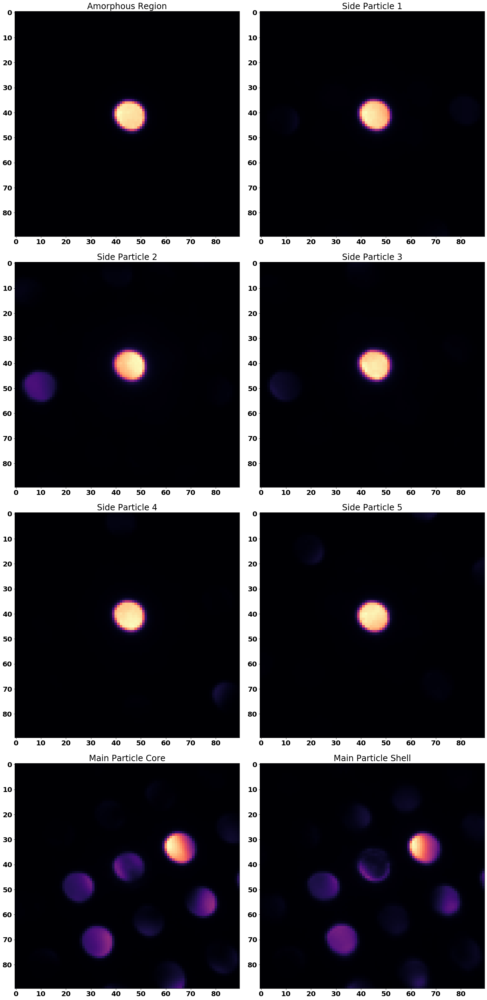

In [32]:
plt.figure(figsize=(20,40))
plt.subplot(4,2,1)
plt.imshow(np.reshape(amorphous_r,mean_binned_cbed.shape))
plt.title('Amorphous Region')
plt.subplot(4,2,2)
plt.imshow(np.reshape(side_part_1,mean_binned_cbed.shape))
plt.title('Side Particle 1')
plt.subplot(4,2,3)
plt.imshow(np.reshape(side_part_2,mean_binned_cbed.shape))
plt.title('Side Particle 2')
plt.subplot(4,2,4)
plt.imshow(np.reshape(side_part_3,mean_binned_cbed.shape))
plt.title('Side Particle 3')
plt.subplot(4,2,5)
plt.imshow(np.reshape(side_part_4,mean_binned_cbed.shape))
plt.title('Side Particle 4')
plt.subplot(4,2,6)
plt.imshow(np.reshape(side_part_5,mean_binned_cbed.shape))
plt.title('Side Particle 5')
plt.subplot(4,2,7)
plt.imshow(np.reshape(main_part_c,mean_binned_cbed.shape))
plt.title('Main Particle Core')
plt.subplot(4,2,8)
plt.imshow(np.reshape(main_part_s,mean_binned_cbed.shape))
plt.title('Main Particle Shell')

plt.tight_layout()

In [33]:
mcrar = pymcr.mcr.McrAR(max_iter=20, st_regr='NNLS', 
                        c_regr=pymcr.regressors.OLS(), 
                        c_constraints=[pymcr.constraints.ConstraintNonneg(), 
                                       pymcr.constraints.ConstraintNorm()])

In [34]:
st.tic()
mcrar.fit(strain4D_2col, ST=spectra, verbose=True)
print('\nFinal MSE: {:.7e}'.format(mcrar.err[-1]))
st.toc()


Final MSE: 4.4810007e+03
Elapsed time: 594.693175 seconds.



In [35]:
conc_profiles = mcrar.C_opt_
spec_profiles = mcrar.ST_opt_
amorphous_r_conc = np.reshape(conc_profiles[:,0],binned_strain4D.shape[2:4])
side_part_1_conc = np.reshape(conc_profiles[:,1],binned_strain4D.shape[2:4])
side_part_2_conc = np.reshape(conc_profiles[:,2],binned_strain4D.shape[2:4])
side_part_3_conc = np.reshape(conc_profiles[:,3],binned_strain4D.shape[2:4])
side_part_4_conc = np.reshape(conc_profiles[:,4],binned_strain4D.shape[2:4])
side_part_5_conc = np.reshape(conc_profiles[:,5],binned_strain4D.shape[2:4])
main_part_c_conc = np.reshape(conc_profiles[:,6],binned_strain4D.shape[2:4])
main_part_s_conc = np.reshape(conc_profiles[:,7],binned_strain4D.shape[2:4])
amorphous_r_spec = np.reshape(spec_profiles[0,:],binned_strain4D.shape[0:2])
side_part_1_spec = np.reshape(spec_profiles[1,:],binned_strain4D.shape[0:2])
side_part_2_spec = np.reshape(spec_profiles[2,:],binned_strain4D.shape[0:2])
side_part_3_spec = np.reshape(spec_profiles[3,:],binned_strain4D.shape[0:2])
side_part_4_spec = np.reshape(spec_profiles[4,:],binned_strain4D.shape[0:2])
side_part_5_spec = np.reshape(spec_profiles[5,:],binned_strain4D.shape[0:2])
main_part_c_spec = np.reshape(spec_profiles[6,:],binned_strain4D.shape[0:2])
main_part_s_spec = np.reshape(spec_profiles[7,:],binned_strain4D.shape[0:2])

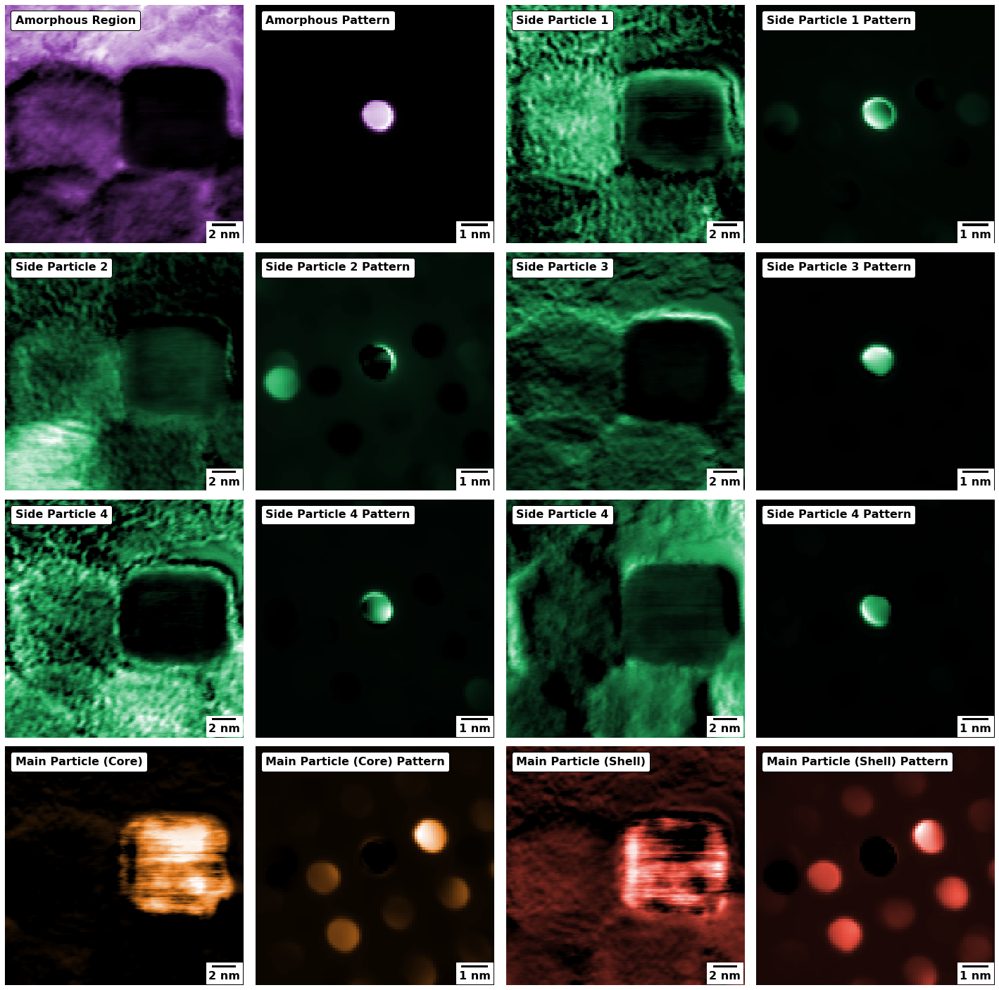

In [189]:
font_size = int(16)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

plt.figure(figsize=(20,20))

plt.subplot(4,4,1)
plt.imshow(amorphous_r_conc,cmap=vl_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Amorphous Region',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,2)
plt.imshow(amorphous_r_spec,cmap=vl_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Amorphous Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,3)
plt.imshow(side_part_1_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 1',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,4)
plt.imshow(side_part_1_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 1 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,5)
plt.imshow(side_part_2_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 2',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,6)
plt.imshow(side_part_2_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 2 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,7)
plt.imshow(side_part_3_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 3',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,8)
plt.imshow(side_part_3_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 3 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')


plt.subplot(4,4,9)
plt.imshow(side_part_4_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,10)
plt.imshow(side_part_4_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,11)
plt.imshow(side_part_5_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,12)
plt.imshow(side_part_5_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,13)
plt.imshow(main_part_c_conc,cmap=or_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Core)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,14)
plt.imshow(main_part_c_spec,cmap=or_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Core) Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,15)
plt.imshow(main_part_s_conc,cmap=rd_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Shell)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,16)
plt.imshow(main_part_s_spec,cmap=rd_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Shell) Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.tight_layout()
plt.savefig('Results_4D/Particle1_MCR_Raw.pdf',bbox_inches = 'tight')

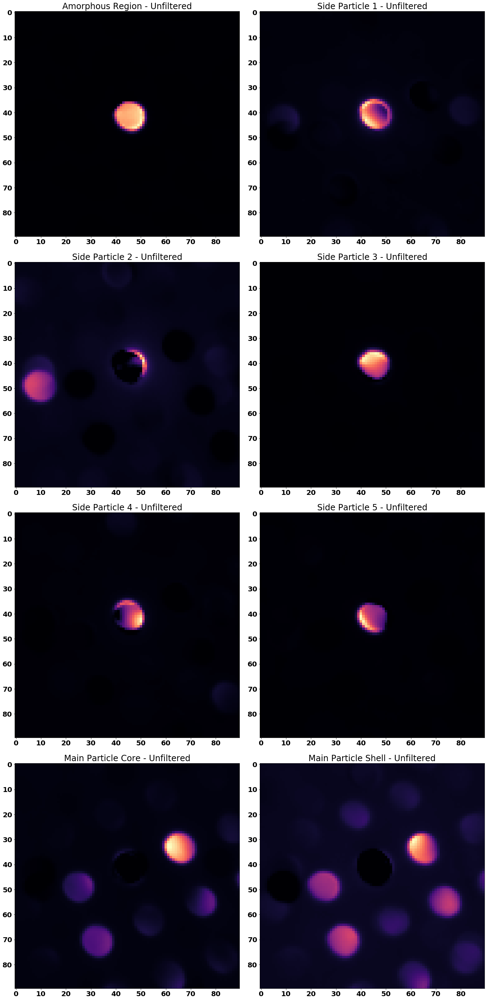

In [37]:
plt.figure(figsize=(20,40))
plt.subplot(4,2,1)
plt.imshow(amorphous_r_spec)
plt.title('Amorphous Region - Unfiltered')
plt.subplot(4,2,2)
plt.imshow(side_part_1_spec)
plt.title('Side Particle 1 - Unfiltered')
plt.subplot(4,2,3)
plt.imshow(side_part_2_spec)
plt.title('Side Particle 2 - Unfiltered')
plt.subplot(4,2,4)
plt.imshow(side_part_3_spec)
plt.title('Side Particle 3 - Unfiltered')
plt.subplot(4,2,5)
plt.imshow(side_part_4_spec)
plt.title('Side Particle 4 - Unfiltered')
plt.subplot(4,2,6)
plt.imshow(side_part_5_spec)
plt.title('Side Particle 5 - Unfiltered')
plt.subplot(4,2,7)
plt.imshow(main_part_c_spec)
plt.title('Main Particle Core - Unfiltered')
plt.subplot(4,2,8)
plt.imshow(main_part_s_spec)
plt.title('Main Particle Shell - Unfiltered')

plt.tight_layout()

Average fractional residual =  0.2556072749460344


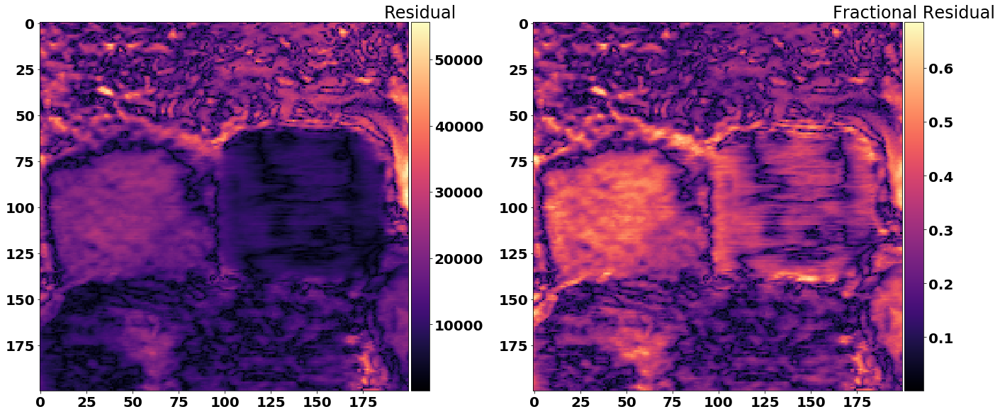

In [38]:
ressquare = np.sum(np.reshape((np.matmul(mcrar.C_opt_, mcrar.ST_opt_))**2, 
                              (amorphous_r_conc.shape[0],amorphous_r_conc.shape[1],
                               amorphous_r_spec.shape[0],amorphous_r_spec.shape[1])) 
                   - np.transpose(binned_strain4D,(2,3,0,1))**2, axis = (2,3))
fractres = np.sqrt(np.abs(ressquare/np.sum(np.transpose(binned_strain4D,(2,3,0,1))**2, axis = (2,3))))
 
print('Average fractional residual = ', np.mean(fractres, axis = (0,1)))
 
plt.figure(figsize = (20,10))
plt.subplot(121)
im1 = plt.imshow(np.sqrt(np.abs(ressquare)))
st.util.sane_colorbar(im1)
plt.title('Residual')
 
plt.subplot(122)
im2 = plt.imshow(fractres)
st.util.sane_colorbar(im2)
plt.title('Fractional Residual')

plt.tight_layout()

In [46]:
st.tic()
strain4D_log = st.util.image_logarizer(binned_strain4D,64)
strain4D_2log = (st.nbed.data4Dto2D(strain4D_log)).astype(np.float64)
st.toc()

Elapsed time: 14.602906 seconds.



Elapsed time: 3.732311 seconds.



Text(0.5, 1.0, 'Main Particle Shell')

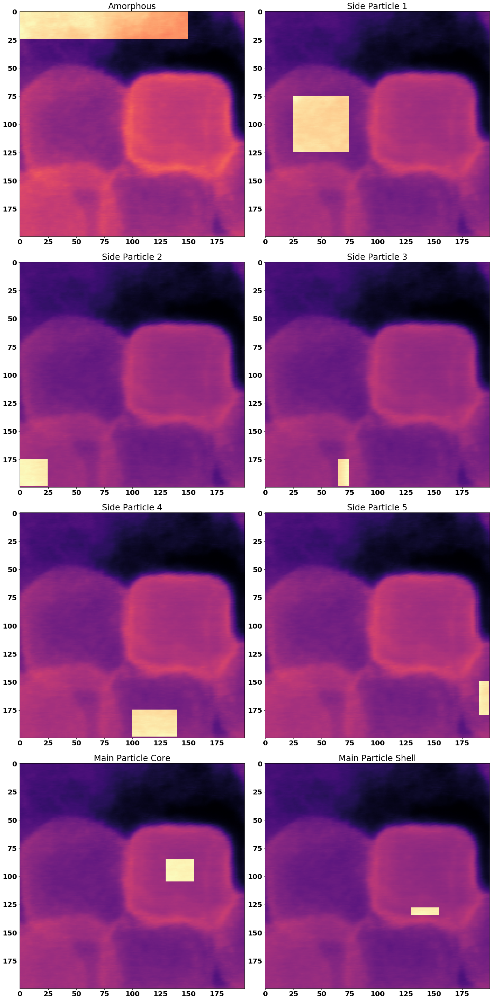

In [47]:
st.tic()
amorphous_r_log,amorphous_r_log_im = st.nbed.spectra_finder(strain4D_log,(0,25),(0,150))
side_part_1_log,side_part_1_log_im = st.nbed.spectra_finder(strain4D_log,(75,125),(25,75))
side_part_2_log,side_part_2_log_im = st.nbed.spectra_finder(strain4D_log,(175,-1),(0,25))
side_part_3_log,side_part_3_log_im = st.nbed.spectra_finder(strain4D_log,(175,-1),(65,75))
side_part_4_log,side_part_4_log_im = st.nbed.spectra_finder(strain4D_log,(175,-1),(100,140))
side_part_5_log,side_part_5_log_im = st.nbed.spectra_finder(strain4D_log,(150,180),(190,-1))
main_part_c_log,main_part_c_log_im = st.nbed.spectra_finder(strain4D_log,(85,105),(130,155))
main_part_s_log,main_part_s_log_im = st.nbed.spectra_finder(strain4D_log,(128,135),(130,155))
st.toc()
plt.figure(figsize=(20,40))
plt.subplot(4,2,1)
plt.imshow(amorphous_r_log_im)
plt.title('Amorphous')
plt.subplot(4,2,2)
plt.imshow(side_part_1_log_im)
plt.title('Side Particle 1')
plt.subplot(4,2,3)
plt.imshow(side_part_2_log_im)
plt.title('Side Particle 2')
plt.subplot(4,2,4)
plt.imshow(side_part_3_log_im)
plt.title('Side Particle 3')
plt.subplot(4,2,5)
plt.imshow(side_part_4_log_im)
plt.title('Side Particle 4')
plt.subplot(4,2,6)
plt.imshow(side_part_5_log_im)
plt.title('Side Particle 5')
plt.subplot(4,2,7)
plt.imshow(main_part_c_log_im)
plt.title('Main Particle Core')
plt.subplot(4,2,8)
plt.imshow(main_part_s_log_im)
plt.title('Main Particle Shell')

In [48]:
spectra_log = np.asarray((amorphous_r_log,
                          side_part_1_log,
                          side_part_2_log,
                          side_part_3_log,
                          side_part_4_log,
                          side_part_5_log,
                          main_part_c_log,
                          main_part_s_log))

In [49]:
strain4D_2log.shape,spectra_log.shape

((40000, 8100), (8, 8100))

Text(0.5, 1.0, 'Main Particle Shell - Log')

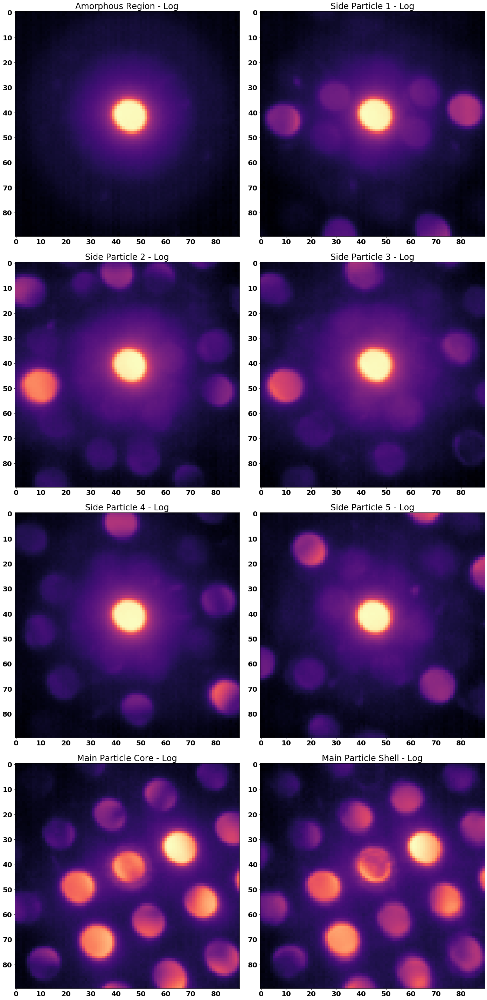

In [50]:
plt.figure(figsize=(20,40))
plt.subplot(4,2,1)
plt.imshow(np.reshape(amorphous_r_log,mean_binned_cbed.shape))
plt.title('Amorphous Region - Log')
plt.subplot(4,2,2)
plt.imshow(np.reshape(side_part_1_log,mean_binned_cbed.shape))
plt.title('Side Particle 1 - Log')
plt.subplot(4,2,3)
plt.imshow(np.reshape(side_part_2_log,mean_binned_cbed.shape))
plt.title('Side Particle 2 - Log')
plt.subplot(4,2,4)
plt.imshow(np.reshape(side_part_3_log,mean_binned_cbed.shape))
plt.title('Side Particle 3 - Log')
plt.subplot(4,2,5)
plt.imshow(np.reshape(side_part_4_log,mean_binned_cbed.shape))
plt.title('Side Particle 4 - Log')
plt.subplot(4,2,6)
plt.imshow(np.reshape(side_part_5_log,mean_binned_cbed.shape))
plt.title('Side Particle 5 - Log')
plt.subplot(4,2,7)
plt.imshow(np.reshape(main_part_c_log,mean_binned_cbed.shape))
plt.title('Main Particle Core - Log')
plt.subplot(4,2,8)
plt.imshow(np.reshape(main_part_s_log,mean_binned_cbed.shape))
plt.title('Main Particle Shell - Log')

In [51]:
mcrar_log = pymcr.mcr.McrAR(max_iter=20, st_regr='NNLS', 
                            c_regr=pymcr.regressors.OLS(), 
                            c_constraints=[pymcr.constraints.ConstraintNonneg(), 
                                           pymcr.constraints.ConstraintNorm()])

In [52]:
st.tic()
mcrar_log.fit(strain4D_2log, ST=spectra_log, verbose=True)
print('\nFinal MSE: {:.7e}'.format(mcrar_log.err[-1]))
st.toc()


Final MSE: 1.7855651e-01
Elapsed time: 1655.209733 seconds.



In [53]:
conc_profiles_log = mcrar_log.C_opt_
spec_profiles_log = mcrar_log.ST_opt_
amorphous_r_log_conc = np.reshape(conc_profiles_log[:,0],strain4D_log.shape[2:4])
side_part_1_log_conc = np.reshape(conc_profiles_log[:,1],strain4D_log.shape[2:4])
side_part_2_log_conc = np.reshape(conc_profiles_log[:,2],strain4D_log.shape[2:4])
side_part_3_log_conc = np.reshape(conc_profiles_log[:,3],strain4D_log.shape[2:4])
side_part_4_log_conc = np.reshape(conc_profiles_log[:,4],strain4D_log.shape[2:4])
side_part_5_log_conc = np.reshape(conc_profiles_log[:,5],strain4D_log.shape[2:4])
main_part_c_log_conc = np.reshape(conc_profiles_log[:,6],strain4D_log.shape[2:4])
main_part_s_log_conc = np.reshape(conc_profiles_log[:,7],strain4D_log.shape[2:4])
amorphous_r_log_spec = np.reshape(spec_profiles_log[0,:],strain4D_log.shape[0:2])
side_part_1_log_spec = np.reshape(spec_profiles_log[1,:],strain4D_log.shape[0:2])
side_part_2_log_spec = np.reshape(spec_profiles_log[2,:],strain4D_log.shape[0:2])
side_part_3_log_spec = np.reshape(spec_profiles_log[3,:],strain4D_log.shape[0:2])
side_part_4_log_spec = np.reshape(spec_profiles_log[4,:],strain4D_log.shape[0:2])
side_part_5_log_spec = np.reshape(spec_profiles_log[5,:],strain4D_log.shape[0:2])
main_part_c_log_spec = np.reshape(spec_profiles_log[6,:],strain4D_log.shape[0:2])
main_part_s_log_spec = np.reshape(spec_profiles_log[7,:],strain4D_log.shape[0:2])

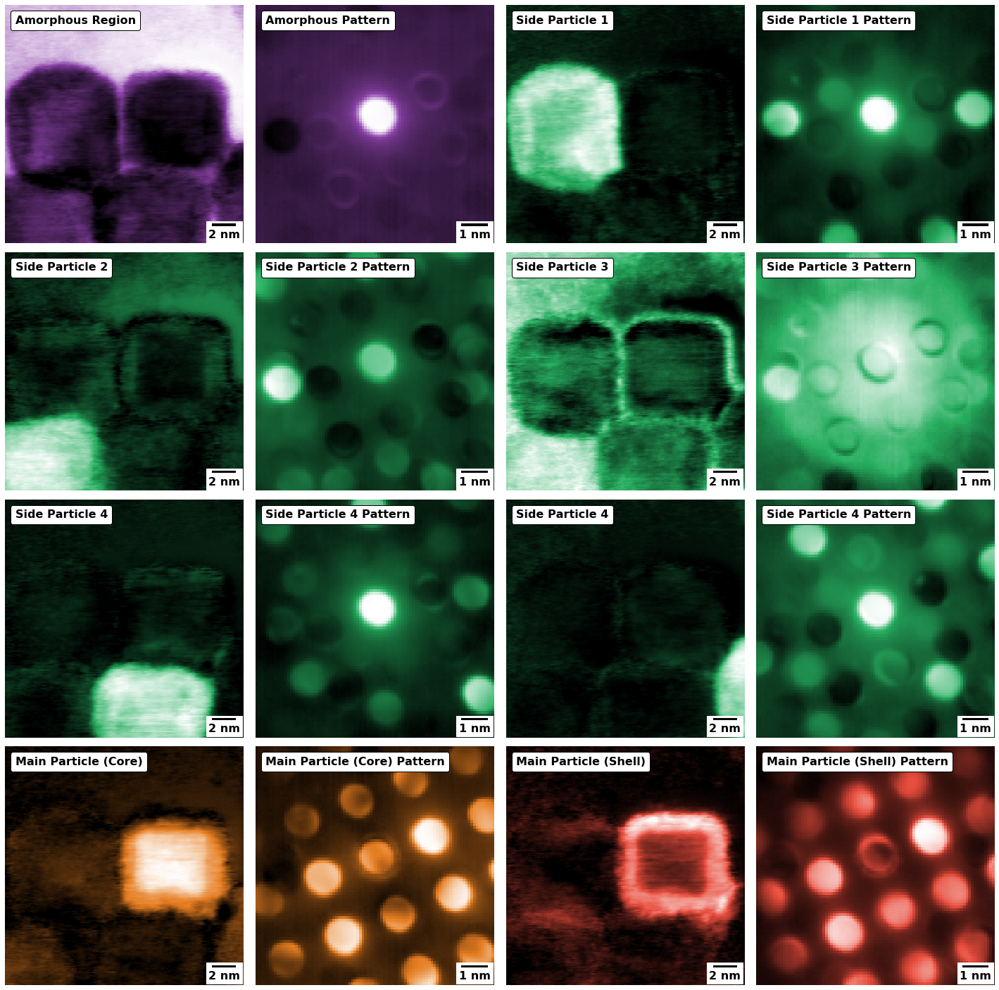

In [188]:
font_size = int(16)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

plt.figure(figsize=(20,20))

plt.subplot(4,4,1)
plt.imshow(amorphous_r_log_conc,cmap=vl_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Amorphous Region',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,2)
plt.imshow(amorphous_r_log_spec,cmap=vl_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Amorphous Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,3)
plt.imshow(side_part_1_log_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 1',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,4)
plt.imshow(side_part_1_log_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 1 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,5)
plt.imshow(side_part_2_log_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 2',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,6)
plt.imshow(side_part_2_log_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 2 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,7)
plt.imshow(side_part_3_log_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 3',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,8)
plt.imshow(side_part_3_log_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 3 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')


plt.subplot(4,4,9)
plt.imshow(side_part_4_log_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,10)
plt.imshow(side_part_4_log_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,11)
plt.imshow(side_part_5_log_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,12)
plt.imshow(side_part_5_log_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,13)
plt.imshow(main_part_c_log_conc,cmap=or_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Core)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,14)
plt.imshow(main_part_c_log_spec,cmap=or_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Core) Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,15)
plt.imshow(main_part_s_log_conc,cmap=rd_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Shell)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,16)
plt.imshow(main_part_s_log_spec,cmap=rd_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Shell) Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.tight_layout()
plt.savefig('Results_4D/Particle1_MCR_Log.pdf',bbox_inches = 'tight')

Text(0.5, 1.0, 'Main Particle Shell - Log')

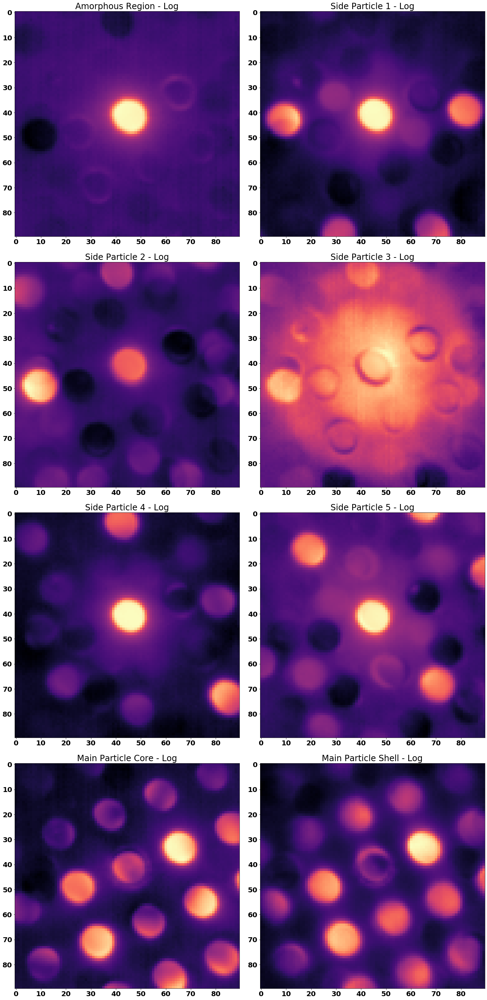

In [55]:
plt.figure(figsize=(20,40))
plt.subplot(4,2,1)
plt.imshow(amorphous_r_log_spec)
plt.title('Amorphous Region - Log')
plt.subplot(4,2,2)
plt.imshow(side_part_1_log_spec)
plt.title('Side Particle 1 - Log')
plt.subplot(4,2,3)
plt.imshow(side_part_2_log_spec)
plt.title('Side Particle 2 - Log')
plt.subplot(4,2,4)
plt.imshow(side_part_3_log_spec)
plt.title('Side Particle 3 - Log')
plt.subplot(4,2,5)
plt.imshow(side_part_4_log_spec)
plt.title('Side Particle 4 - Log')
plt.subplot(4,2,6)
plt.imshow(side_part_5_log_spec)
plt.title('Side Particle 5 - Log')
plt.subplot(4,2,7)
plt.imshow(main_part_c_log_spec)
plt.title('Main Particle Core - Log')
plt.subplot(4,2,8)
plt.imshow(main_part_s_log_spec)
plt.title('Main Particle Shell - Log')

Average fractional residual =  0.04983905424098727


Text(0.5, 1.0, 'Fractional Residual of Log')

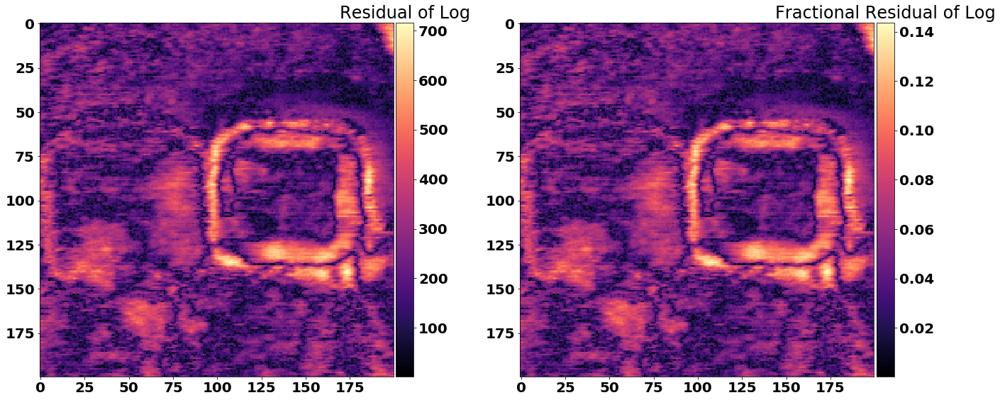

In [56]:
ressquare = np.sum(np.reshape((np.matmul(mcrar_log.C_opt_, mcrar_log.ST_opt_))**2, 
                              (amorphous_r_log_conc.shape[0],amorphous_r_log_conc.shape[1],
                               amorphous_r_log_spec.shape[0],amorphous_r_log_spec.shape[1])) 
                   - np.transpose(strain4D_log,(2,3,0,1))**2, axis = (2,3))
fractres = np.sqrt(np.abs(ressquare/np.sum(np.transpose(strain4D_log,(2,3,0,1))**2, axis = (2,3))))
 
print('Average fractional residual = ', np.mean(fractres, axis = (0,1)))
 
plt.figure(figsize = (20,10))
plt.subplot(121)
im1 = plt.imshow(np.sqrt(np.abs(ressquare)))
st.util.sane_colorbar(im1)
plt.title('Residual of Log')
 
plt.subplot(122)
im2 = plt.imshow(fractres)
st.util.sane_colorbar(im2)
plt.title('Fractional Residual of Log')

In [57]:
binned_strain4D.shape

(90, 90, 200, 200)

In [58]:
%timeit st.nbed.log_sobel4D(binned_strain4D[:,:,0:20,0:20],(-1,-2),50,0.5)

2.87 s ± 155 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [59]:
st.tic()
strain4D_lsb = st.nbed.log_sobel4D(binned_strain4D,(-1,-2))
strain4D_2lsb = (st.nbed.data4Dto2D(strain4D_lsb)).astype(float)
st.toc()

Elapsed time: 287.282157 seconds.



Elapsed time: 4.193643 seconds.

Elapsed time: 0.000292 seconds.



Text(0.5, 1.0, 'Main Particle Shell')

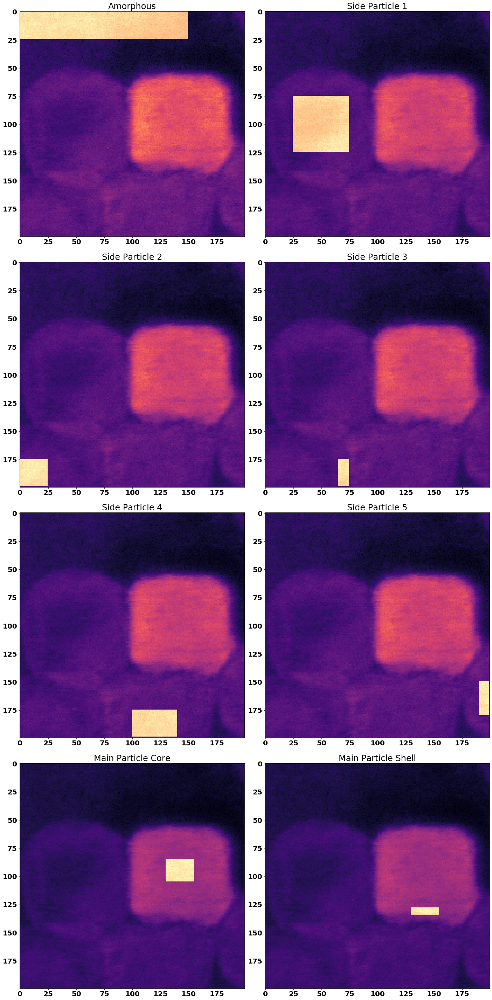

In [60]:
st.tic()
amorphous_r_lsb,amorphous_r_lsb_im = st.nbed.spectra_finder(strain4D_lsb,(0,25),(0,150))
side_part_1_lsb,side_part_1_lsb_im = st.nbed.spectra_finder(strain4D_lsb,(75,125),(25,75))
side_part_2_lsb,side_part_2_lsb_im = st.nbed.spectra_finder(strain4D_lsb,(175,-1),(0,25))
side_part_3_lsb,side_part_3_lsb_im = st.nbed.spectra_finder(strain4D_lsb,(175,-1),(65,75))
side_part_4_lsb,side_part_4_lsb_im = st.nbed.spectra_finder(strain4D_lsb,(175,-1),(100,140))
side_part_5_lsb,side_part_5_lsb_im = st.nbed.spectra_finder(strain4D_lsb,(150,180),(190,-1))
main_part_c_lsb,main_part_c_lsb_im = st.nbed.spectra_finder(strain4D_lsb,(85,105),(130,155))
main_part_s_lsb,main_part_s_lsb_im = st.nbed.spectra_finder(strain4D_lsb,(128,135),(130,155))
st.toc()
st.toc()
plt.figure(figsize=(20,40))
plt.subplot(4,2,1)
plt.imshow(amorphous_r_lsb_im)
plt.title('Amorphous')
plt.subplot(4,2,2)
plt.imshow(side_part_1_lsb_im)
plt.title('Side Particle 1')
plt.subplot(4,2,3)
plt.imshow(side_part_2_lsb_im)
plt.title('Side Particle 2')
plt.subplot(4,2,4)
plt.imshow(side_part_3_lsb_im)
plt.title('Side Particle 3')
plt.subplot(4,2,5)
plt.imshow(side_part_4_lsb_im)
plt.title('Side Particle 4')
plt.subplot(4,2,6)
plt.imshow(side_part_5_lsb_im)
plt.title('Side Particle 5')
plt.subplot(4,2,7)
plt.imshow(main_part_c_lsb_im)
plt.title('Main Particle Core')
plt.subplot(4,2,8)
plt.imshow(main_part_s_lsb_im)
plt.title('Main Particle Shell')

In [61]:
spectra_lsb = np.asarray((amorphous_r_lsb,
                          side_part_1_lsb,
                          side_part_2_lsb,
                          side_part_3_lsb,
                          side_part_4_lsb,
                          side_part_5_lsb,
                          main_part_c_lsb,
                          main_part_s_lsb))

In [62]:
strain4D_2lsb.shape,spectra_lsb.shape

((40000, 8100), (8, 8100))

Text(0.5, 1.0, 'Main Particle Shell - Log Sobel')

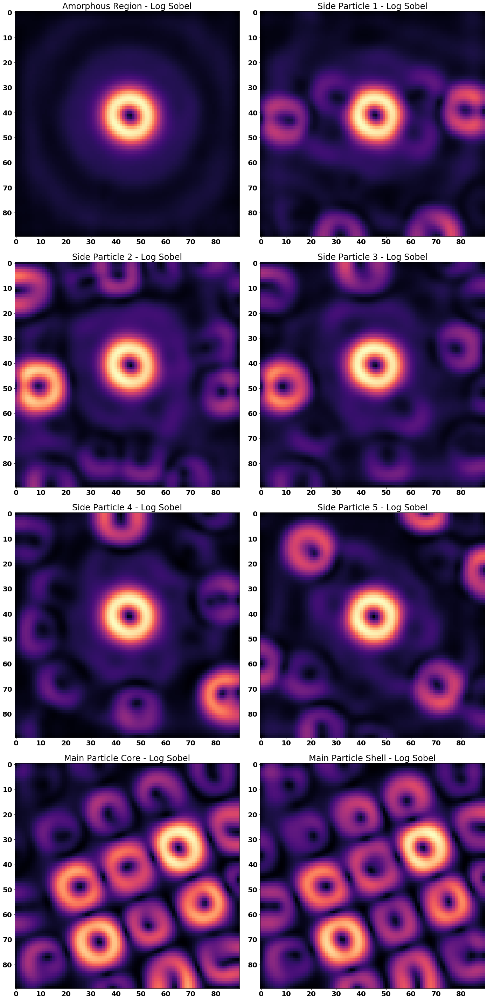

In [63]:
plt.figure(figsize=(20,40))
plt.subplot(4,2,1)
plt.imshow(np.reshape(amorphous_r_lsb,mean_binned_cbed.shape))
plt.title('Amorphous Region - Log Sobel')
plt.subplot(4,2,2)
plt.imshow(np.reshape(side_part_1_lsb,mean_binned_cbed.shape))
plt.title('Side Particle 1 - Log Sobel')
plt.subplot(4,2,3)
plt.imshow(np.reshape(side_part_2_lsb,mean_binned_cbed.shape))
plt.title('Side Particle 2 - Log Sobel')
plt.subplot(4,2,4)
plt.imshow(np.reshape(side_part_3_lsb,mean_binned_cbed.shape))
plt.title('Side Particle 3 - Log Sobel')
plt.subplot(4,2,5)
plt.imshow(np.reshape(side_part_4_lsb,mean_binned_cbed.shape))
plt.title('Side Particle 4 - Log Sobel')
plt.subplot(4,2,6)
plt.imshow(np.reshape(side_part_5_lsb,mean_binned_cbed.shape))
plt.title('Side Particle 5 - Log Sobel')
plt.subplot(4,2,7)
plt.imshow(np.reshape(main_part_c_lsb,mean_binned_cbed.shape))
plt.title('Main Particle Core - Log Sobel')
plt.subplot(4,2,8)
plt.imshow(np.reshape(main_part_s_lsb,mean_binned_cbed.shape))
plt.title('Main Particle Shell - Log Sobel')

In [64]:
mcrar_lsb = pymcr.mcr.McrAR(max_iter=5, st_regr='NNLS', 
                            c_regr=pymcr.regressors.OLS(), 
                            c_constraints=[pymcr.constraints.ConstraintNonneg(), 
                                           pymcr.constraints.ConstraintNorm()])

In [65]:
st.tic()
mcrar_lsb.fit(strain4D_2lsb, ST=spectra_lsb, verbose=True)
print('\nFinal MSE: {:.7e}'.format(mcrar_lsb.err[-1]))
st.toc()


Final MSE: 3.8044159e+01
Elapsed time: 184.773157 seconds.



In [66]:
conc_profiles_lsb = mcrar_lsb.C_opt_
spec_profiles_lsb = mcrar_lsb.ST_opt_
amorphous_r_lsb_conc = np.reshape(conc_profiles_lsb[:,0],strain4D_lsb.shape[2:4])
side_part_1_lsb_conc = np.reshape(conc_profiles_lsb[:,1],strain4D_lsb.shape[2:4])
side_part_2_lsb_conc = np.reshape(conc_profiles_lsb[:,2],strain4D_lsb.shape[2:4])
side_part_3_lsb_conc = np.reshape(conc_profiles_lsb[:,3],strain4D_lsb.shape[2:4])
side_part_4_lsb_conc = np.reshape(conc_profiles_lsb[:,4],strain4D_lsb.shape[2:4])
side_part_5_lsb_conc = np.reshape(conc_profiles_lsb[:,5],strain4D_lsb.shape[2:4])
main_part_c_lsb_conc = np.reshape(conc_profiles_lsb[:,6],strain4D_lsb.shape[2:4])
main_part_s_lsb_conc = np.reshape(conc_profiles_lsb[:,7],strain4D_lsb.shape[2:4])
amorphous_r_lsb_spec = np.reshape(spec_profiles_lsb[0,:],strain4D_lsb.shape[0:2])
side_part_1_lsb_spec = np.reshape(spec_profiles_lsb[1,:],strain4D_lsb.shape[0:2])
side_part_2_lsb_spec = np.reshape(spec_profiles_lsb[2,:],strain4D_lsb.shape[0:2])
side_part_3_lsb_spec = np.reshape(spec_profiles_lsb[3,:],strain4D_lsb.shape[0:2])
side_part_4_lsb_spec = np.reshape(spec_profiles_lsb[4,:],strain4D_lsb.shape[0:2])
side_part_5_lsb_spec = np.reshape(spec_profiles_lsb[5,:],strain4D_lsb.shape[0:2])
main_part_c_lsb_spec = np.reshape(spec_profiles_lsb[6,:],strain4D_lsb.shape[0:2])
main_part_s_lsb_spec = np.reshape(spec_profiles_lsb[7,:],strain4D_lsb.shape[0:2])

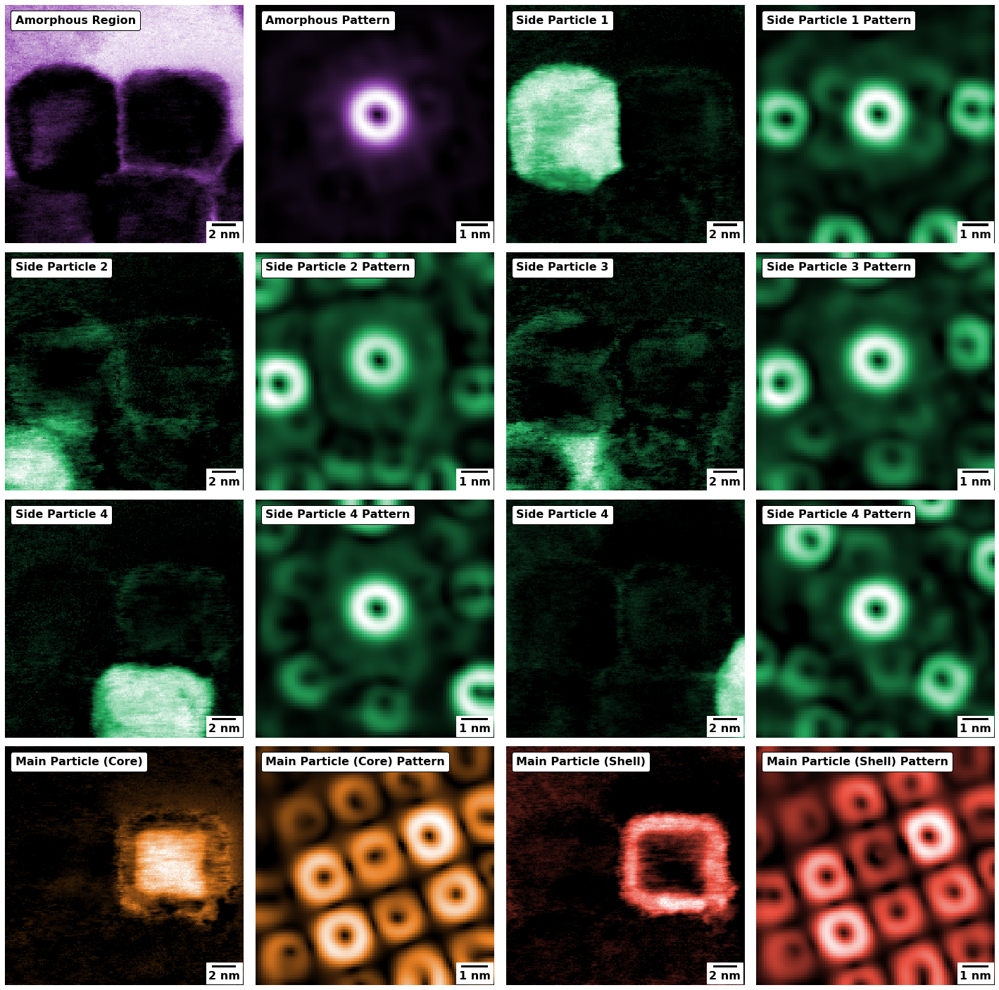

In [187]:
font_size = int(16)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

plt.figure(figsize=(20,20))

plt.subplot(4,4,1)
plt.imshow(amorphous_r_lsb_conc,cmap=vl_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Amorphous Region',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,2)
plt.imshow(amorphous_r_lsb_spec,cmap=vl_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Amorphous Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,3)
plt.imshow(side_part_1_lsb_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 1',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,4)
plt.imshow(side_part_1_lsb_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 1 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,5)
plt.imshow(side_part_2_lsb_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 2',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,6)
plt.imshow(side_part_2_lsb_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 2 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,7)
plt.imshow(side_part_3_lsb_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 3',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,8)
plt.imshow(side_part_3_lsb_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 3 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')


plt.subplot(4,4,9)
plt.imshow(side_part_4_lsb_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,10)
plt.imshow(side_part_4_lsb_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,11)
plt.imshow(side_part_5_lsb_conc,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,12)
plt.imshow(side_part_5_lsb_spec,cmap=gr_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Side Particle 4 Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,13)
plt.imshow(main_part_c_lsb_conc,cmap=or_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Core)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,14)
plt.imshow(main_part_c_lsb_spec,cmap=or_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Core) Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,15)
plt.imshow(main_part_s_lsb_conc,cmap=rd_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Shell)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(4,4,16)
plt.imshow(main_part_s_lsb_spec,cmap=rd_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Main Particle (Shell) Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.tight_layout()
plt.savefig('Results_4D/Particle1_MCR_LogSobel.pdf',bbox_inches = 'tight')

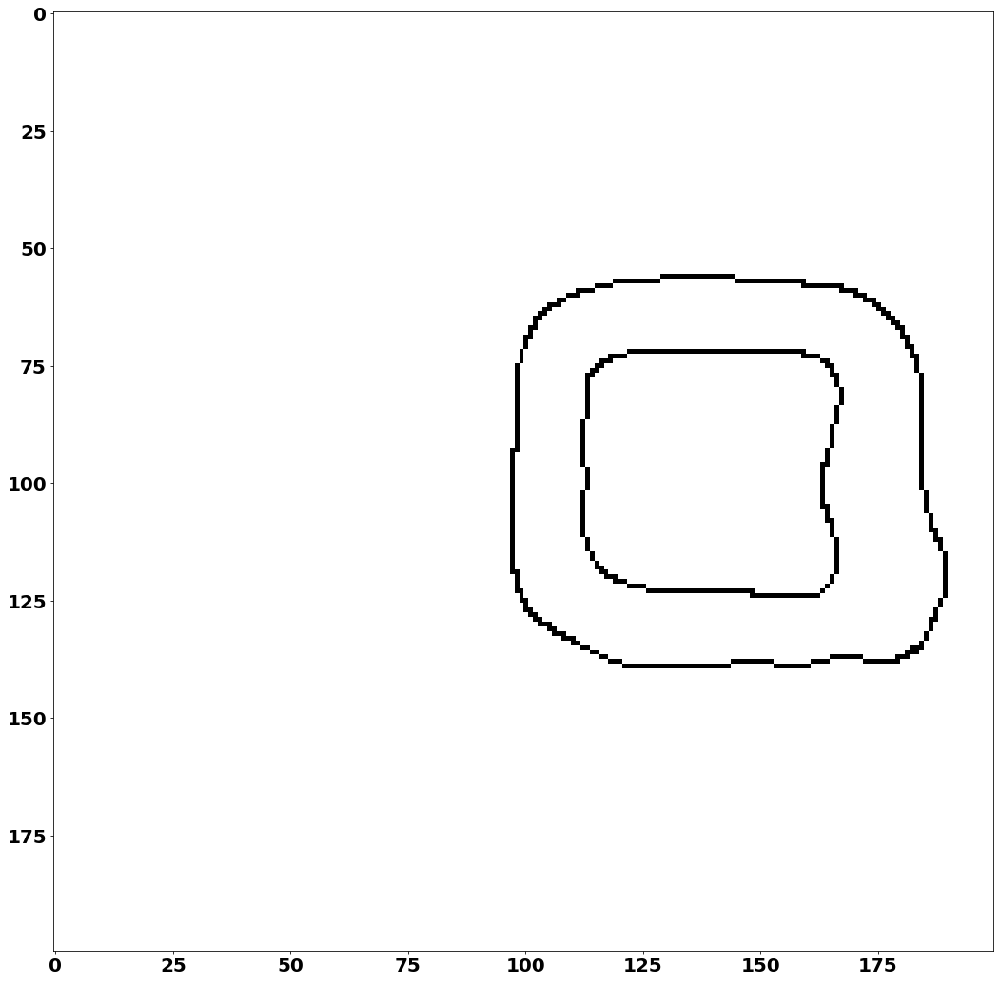

In [68]:
from skimage import feature as skfeat
particle_edge = skfeat.canny(st.util.image_normalizer(main_part_s_lsb_conc),sigma=5)
plt.figure(figsize=(15,15))
plt.imshow(particle_edge,cmap='gray_r')
plt.savefig('Results_4D/Core_Shell_Edges.pdf',bbox_inches = 'tight')

In [77]:
def sort_edges(edge_map,edge_distance=5):
    yV, xV = np.mgrid[0:np.shape(edge_map)[0],0:np.shape(edge_map)[1]]
    dist_points = np.zeros_like(yV)
    yy = yV[edge_map]
    xx = xV[edge_map]
    no_points = np.size(yy)
    points = np.arange(no_points)
    point_list = np.transpose(np.asarray((yV[edge_map],xV[edge_map])))
    truth_list = np.zeros((no_points,2),dtype=bool)
    edge_list_1 = np.zeros((no_points,2))
    point_number = 0
    edge_list_1[int(point_number),0:2] = np.asarray((yy[0],xx[0]))
    truth_list[int(point_number),0:2] = True
    edge_points = 1
    for ii in np.arange(no_points):
        last_yy = edge_list_1[int(edge_points - 1),0]
        last_xx = edge_list_1[int(edge_points - 1),1]
        other_points = np.reshape(point_list[~truth_list],(int(no_points-edge_points),2))
        dist_vals = (((other_points[:,0] - last_yy) ** 2) + ((other_points[:,1] - last_xx) ** 2)) ** 0.5
        min_dist = np.amin(dist_vals)
        if (min_dist < edge_distance):
            n_yy = other_points[dist_vals == min_dist,0][0]
            n_xx = other_points[dist_vals == min_dist,1][0]
            point_number = points[(point_list[:,0] == n_yy) & (point_list[:,1] == n_xx)][0]
            edge_list_1[int(edge_points),0:2] = np.asarray((n_yy,n_xx))
            truth_list[int(point_number),0:2] = True
            edge_points = edge_points + 1.
    list_1 = np.reshape(point_list[truth_list],(int(edge_points),2))
    list_2 = np.reshape(point_list[~truth_list],(int(no_points-edge_points),2))
    edge1 = np.zeros_like(edge_map)
    edge1[list_1[:,0],list_1[:,1]] = 1
    edge2 = np.zeros_like(edge_map)
    edge2[list_2[:,0],list_2[:,1]] = 1
    edge1_sum = np.sum(edge1)
    edge2_sum = np.sum(edge2)
    if (edge1_sum > edge2_sum):
        outer_edge = np.copy(edge1)
        inner_edge = np.copy(edge2)
    else:
        outer_edge = np.copy(edge2)
        inner_edge = np.copy(edge1)
    return outer_edge,inner_edge

Elapsed time: 0.081114 seconds.



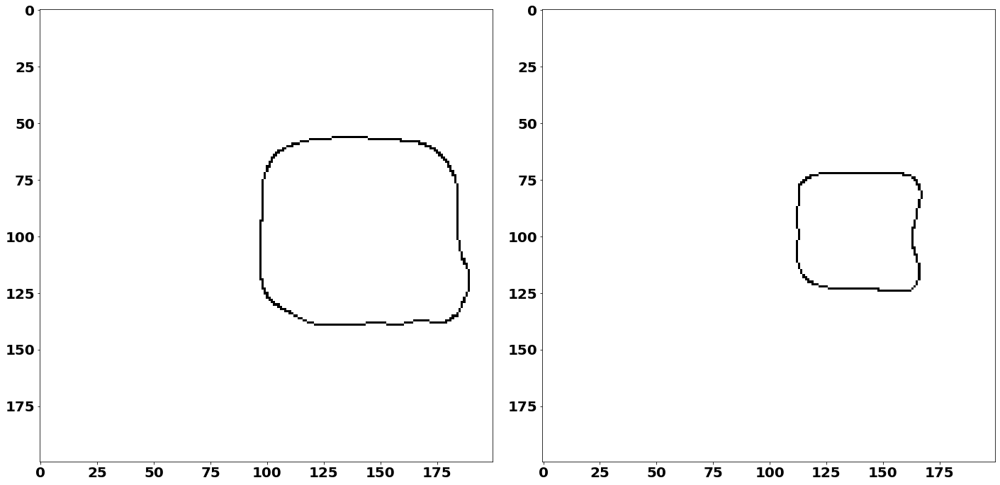

In [95]:
st.tic()
shell_edge,core_shell_interface = sort_edges(particle_edge,8)
core_shell_interface[136,183] = False
st.toc()
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.imshow(shell_edge,cmap='gray_r')
plt.subplot(1,2,2)
plt.imshow(core_shell_interface,cmap='gray_r')

In [96]:
def is_odd(num):
   return num % 2 != 0

@numba.jit
def get_inside(edges):
    aa = edges.astype(float)
    inside = np.zeros(aa.shape)
    for ii in np.arange(aa.shape[0]):
        for jj in np.arange(aa.shape[1]):
            ytest = False
            xtest = False
            ysum = np.sum(aa[ii:-1,jj])
            xsum = np.sum(aa[ii,jj:-1])
            if (ysum < 3):
                ytest = is_odd(ysum)
            if (xsum < 3):
                xtest = is_odd(xsum)
            inside[ii,jj] = np.logical_or(ytest,xtest)
    inside = inside.astype(float)
    inside = scnd.gaussian_filter(inside,3)
    inside[inside < 0.1] = 0
    inside[inside > 0] = 1
    return inside.astype(bool)

In [97]:
%timeit get_inside(core_shell_interface)

2.21 s ± 79.3 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


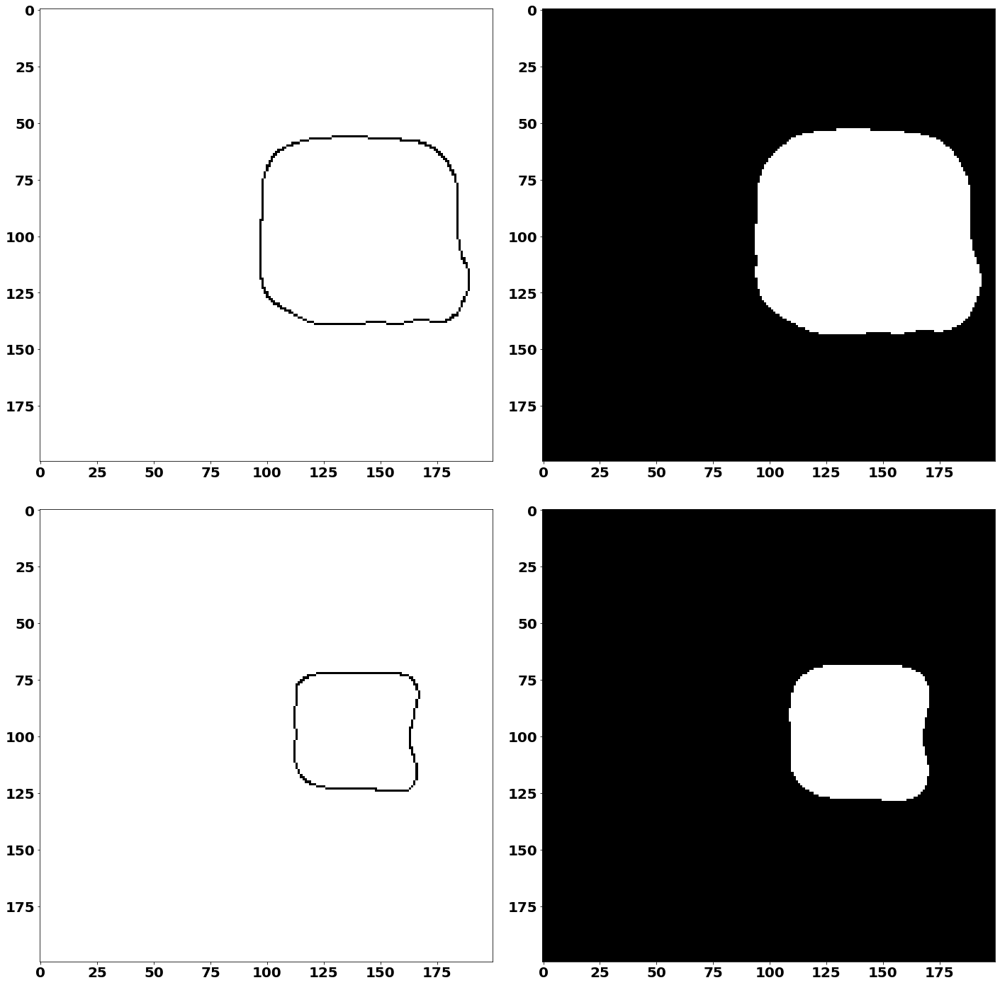

In [98]:
plt.figure(figsize=(20,20))
plt.subplot(2,2,1)
plt.imshow(shell_edge,cmap='gray_r')
plt.subplot(2,2,2)
plt.imshow(get_inside(shell_edge),cmap='gray')
plt.subplot(2,2,3)
plt.imshow(core_shell_interface,cmap='gray_r')
plt.subplot(2,2,4)
plt.imshow(get_inside(core_shell_interface),cmap='gray')
plt.savefig('Results_4D/Core_Shell_Edges_Separated.pdf',bbox_inches = 'tight')

In [99]:
core_ROI = get_inside(core_shell_interface)
total_ROI = get_inside(shell_edge)
shell_ROI  = np.logical_and(total_ROI,np.logical_not(core_ROI))

In [100]:
side_particles = side_part_1_lsb_conc +side_part_2_lsb_conc + side_part_4_lsb_conc + side_part_5_lsb_conc

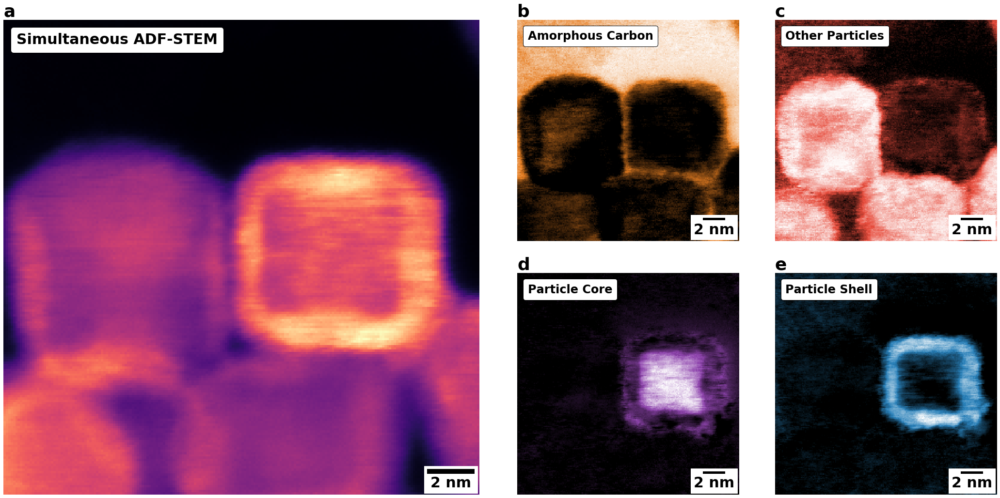

In [182]:
font_size = int(30)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

plt.figure(figsize=(30,15))

gs = mpgs.GridSpec(2, 4)
ax1 = plt.subplot(gs[:, 0:2])
ax2 = plt.subplot(gs[0, 2])
ax3 = plt.subplot(gs[0, -1])
ax4 = plt.subplot(gs[1, 2])
ax5 = plt.subplot(gs[1, -1])

ax1.imshow(simulADF,cmap='magma')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax1.add_artist(scalebar)
at = AnchoredText('Simultaneous ADF-STEM',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax1.add_artist(at)
ax1.set_title('a',loc='left',fontdict=title_font)
ax1.axis('off')

ax2.imshow(amorphous_r_lsb_conc,cmap=or_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax2.add_artist(scalebar)
at = AnchoredText('Amorphous Carbon',
                  prop=dict(size=int(0.8*font_size)), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax2.add_artist(at)
ax2.set_title('b',loc='left',fontdict=title_font)
ax2.axis('off')

ax3.imshow(side_particles,cmap=rd_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax3.add_artist(scalebar)
at = AnchoredText('Other Particles',
                  prop=dict(size=int(0.8*font_size)), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax3.add_artist(at)
ax3.set_title('c',loc='left',fontdict=title_font)
ax3.axis('off')

ax4.imshow(main_part_c_lsb_conc,cmap=vl_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax4.add_artist(scalebar)
at = AnchoredText('Particle Core',
                  prop=dict(size=int(0.8*font_size)), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax4.add_artist(at)
ax4.set_title('d',loc='left',fontdict=title_font)
ax4.axis('off')

ax5.imshow(main_part_s_lsb_conc,cmap=bu_cl)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax5.add_artist(scalebar)
at = AnchoredText('Particle Shell',
                  prop=dict(size=int(0.8*font_size)), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax5.add_artist(at)
ax5.set_title(label='e',loc='left',fontdict=title_font)
ax5.axis('off')

plt.tight_layout()
plt.savefig('Results_4D/Particle1_MCR_LogSobel_Regions.pdf',bbox_inches = 'tight')

Text(0.5, 1.0, 'Main Particle Shell - Log Sobel')

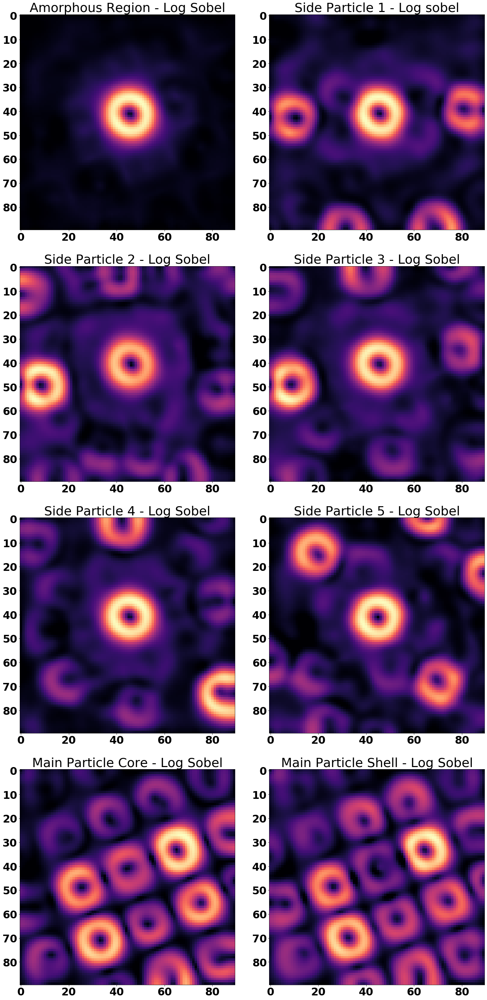

In [102]:
plt.figure(figsize=(20,40))
plt.subplot(4,2,1)
plt.imshow(amorphous_r_lsb_spec)
plt.title('Amorphous Region - Log Sobel')
plt.subplot(4,2,2)
plt.imshow(side_part_1_lsb_spec)
plt.title('Side Particle 1 - Log sobel')
plt.subplot(4,2,3)
plt.imshow(side_part_2_lsb_spec)
plt.title('Side Particle 2 - Log Sobel')
plt.subplot(4,2,4)
plt.imshow(side_part_3_lsb_spec)
plt.title('Side Particle 3 - Log Sobel')
plt.subplot(4,2,5)
plt.imshow(side_part_4_lsb_spec)
plt.title('Side Particle 4 - Log Sobel')
plt.subplot(4,2,6)
plt.imshow(side_part_5_lsb_spec)
plt.title('Side Particle 5 - Log Sobel')
plt.subplot(4,2,7)
plt.imshow(main_part_c_lsb_spec)
plt.title('Main Particle Core - Log Sobel')
plt.subplot(4,2,8)
plt.imshow(main_part_s_lsb_spec)
plt.title('Main Particle Shell - Log Sobel')

Average fractional residual =  0.25350462955705444


Text(0.5, 1.0, 'Fractional Residual of Log')

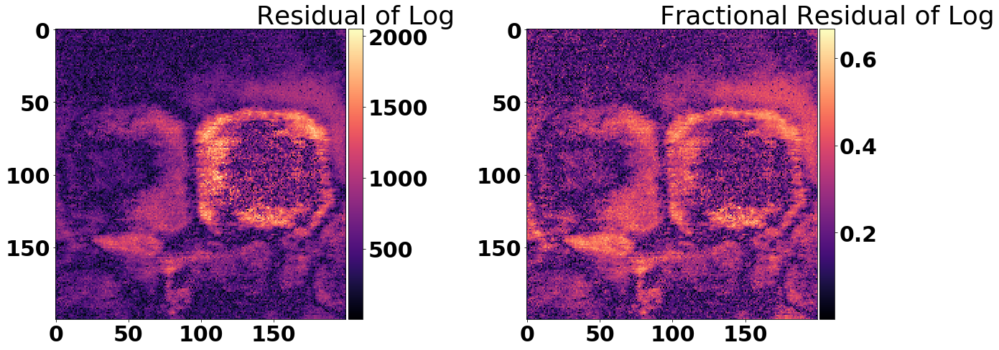

In [103]:
ressquare = np.sum(np.reshape((np.matmul(mcrar_lsb.C_opt_, mcrar_lsb.ST_opt_))**2, 
                              (amorphous_r_lsb_conc.shape[0],amorphous_r_lsb_conc.shape[1],
                               amorphous_r_lsb_spec.shape[0],amorphous_r_lsb_spec.shape[1])) 
                   - np.transpose(strain4D_lsb,(2,3,0,1))**2, axis = (2,3))
fractres = np.sqrt(np.abs(ressquare/np.sum(np.transpose(strain4D_lsb,(2,3,0,1))**2, axis = (2,3))))
 
print('Average fractional residual = ', np.mean(fractres, axis = (0,1)))
 
plt.figure(figsize = (20,10))
plt.subplot(121)
im1 = plt.imshow(np.sqrt(np.abs(ressquare)))
st.util.sane_colorbar(im1)
plt.title('Residual of Log')
 
plt.subplot(122)
im2 = plt.imshow(fractres)
st.util.sane_colorbar(im2)
plt.title('Fractional Residual of Log')

In [104]:
st.tic()
Mean_CBED = np.mean(strain4D,axis=(-1,-2),dtype=np.float64)
st.toc()

Elapsed time: 8.006418 seconds.



Text(0.5, 1.0, 'Log of Mean Diffraction Pattern')

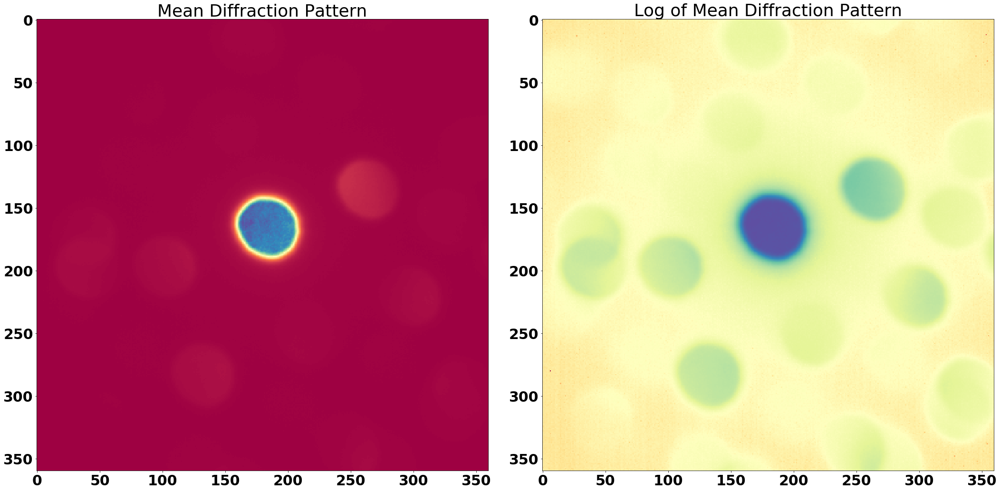

In [105]:
plt.figure(figsize=(30,15))
plt.subplot(1,2,1)
plt.imshow(Mean_CBED,cmap='Spectral')
plt.title('Mean Diffraction Pattern')
plt.subplot(1,2,2)
plt.imshow(st.util.image_logarizer(Mean_CBED,16),cmap='Spectral')
plt.title('Log of Mean Diffraction Pattern')

Text(0.5, 1.0, 'Diffraction Pattern on amorphous carbon')

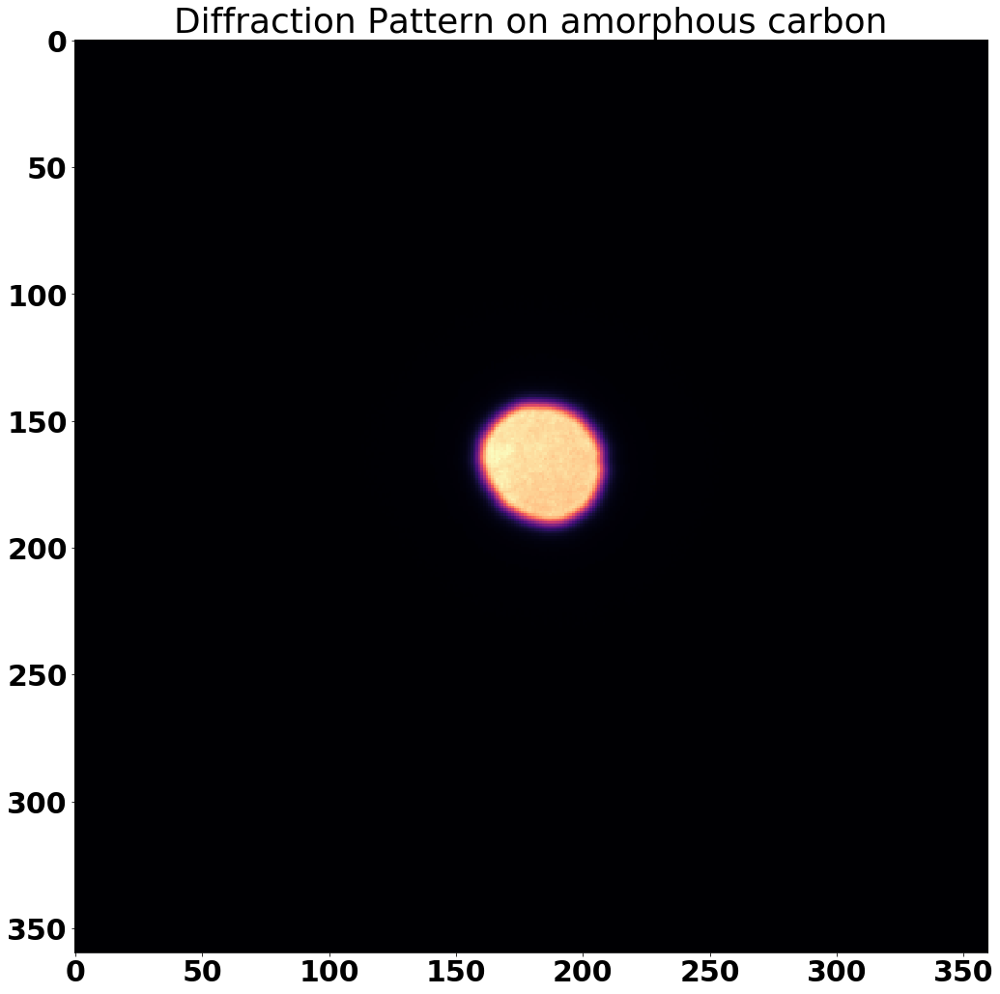

In [106]:
nodiff_cbed = np.mean(strain4D[:,:,0:25,:],axis=(-1,2),dtype=np.float64)
plt.figure(figsize=(15, 15))
plt.imshow(nodiff_cbed)
plt.title('Diffraction Pattern on amorphous carbon')

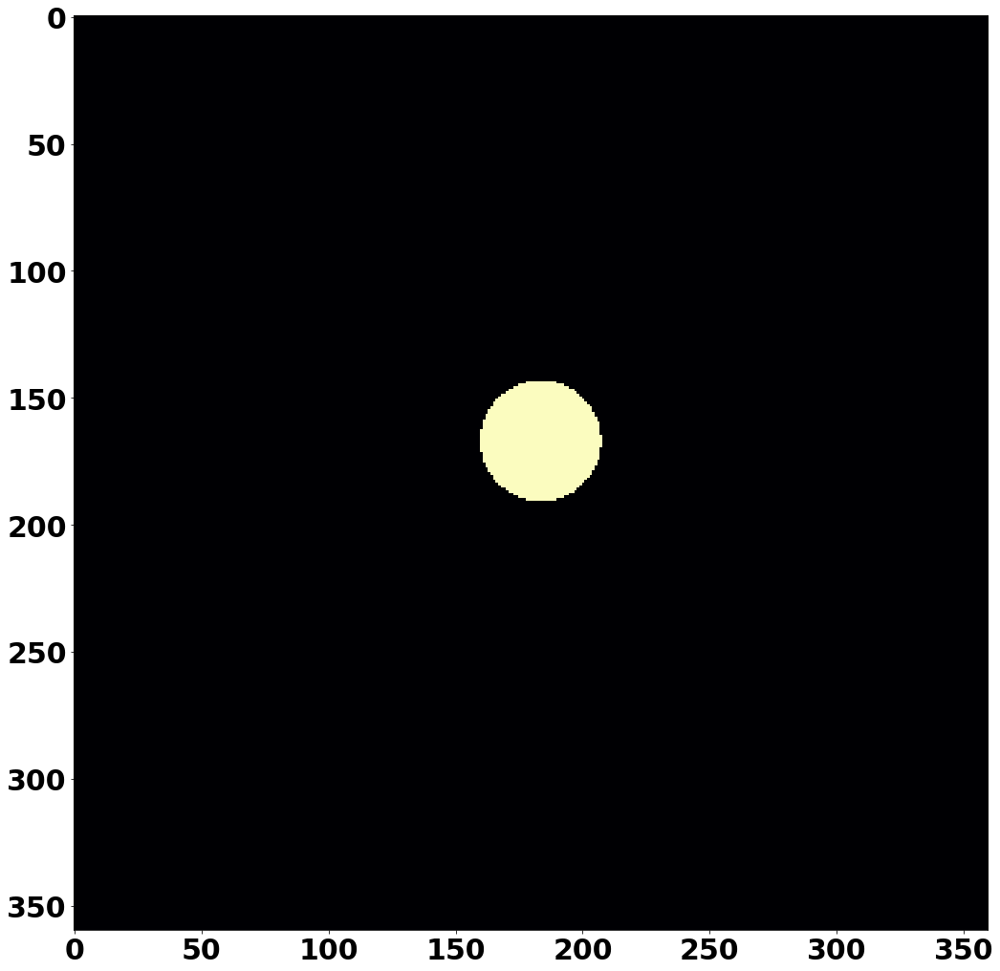

In [107]:
beam_x,beam_y,beam_r = st.util.sobel_circle(nodiff_cbed)
center_disk = st.util.make_circle(np.asarray(nodiff_cbed.shape),beam_x,beam_y,beam_r)
plt.figure(figsize=(15, 15))
plt.imshow(center_disk)

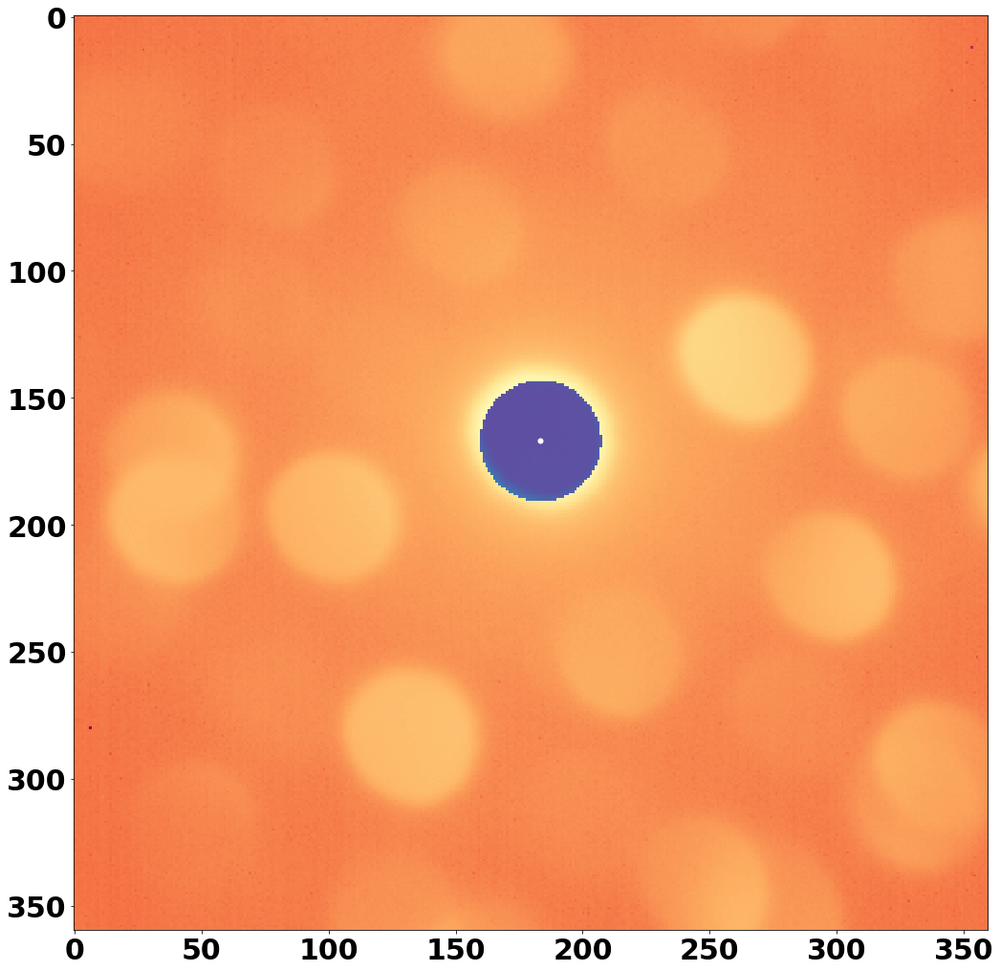

In [108]:
center_pos = (beam_x,beam_y)
center_aperture = st.nbed.test_aperture(st.util.image_logarizer(Mean_CBED,16),center_pos,beam_r)

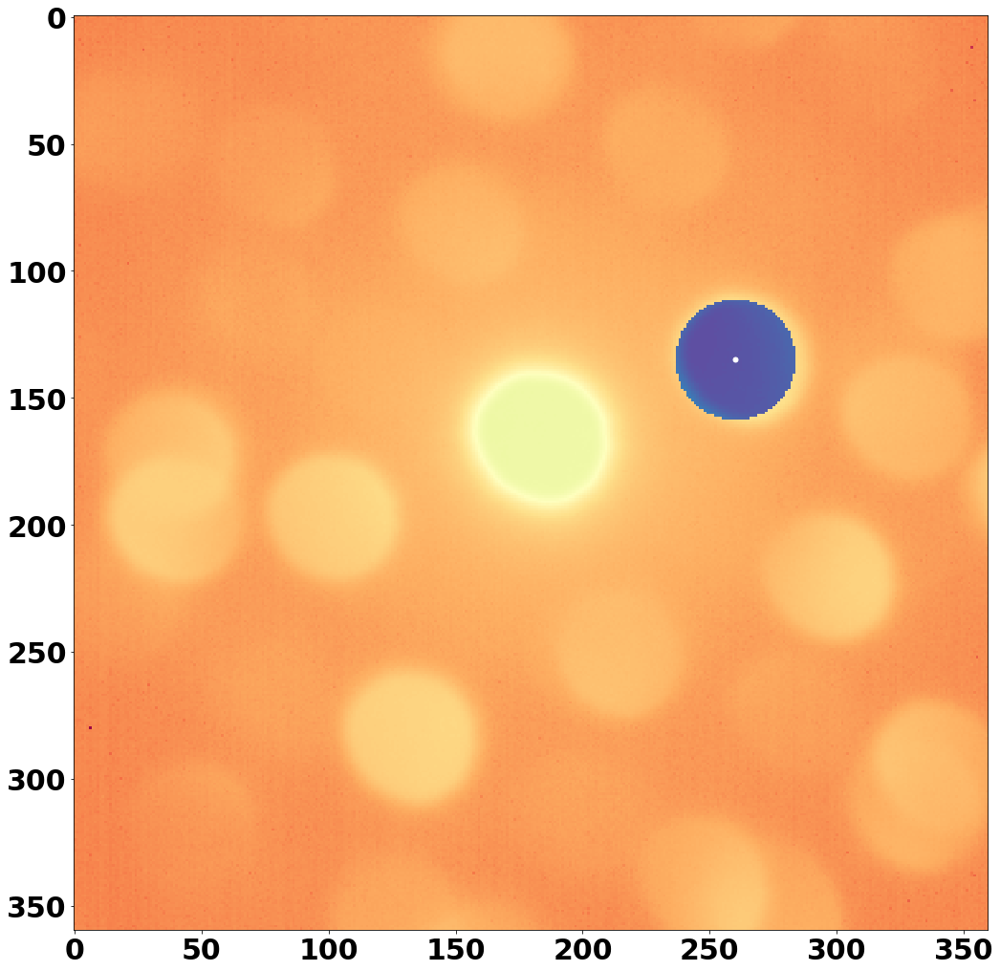

In [109]:
rr_pos = (260,135)
rr_aperture = st.nbed.test_aperture(st.util.image_logarizer(Mean_CBED,16),rr_pos,beam_r)

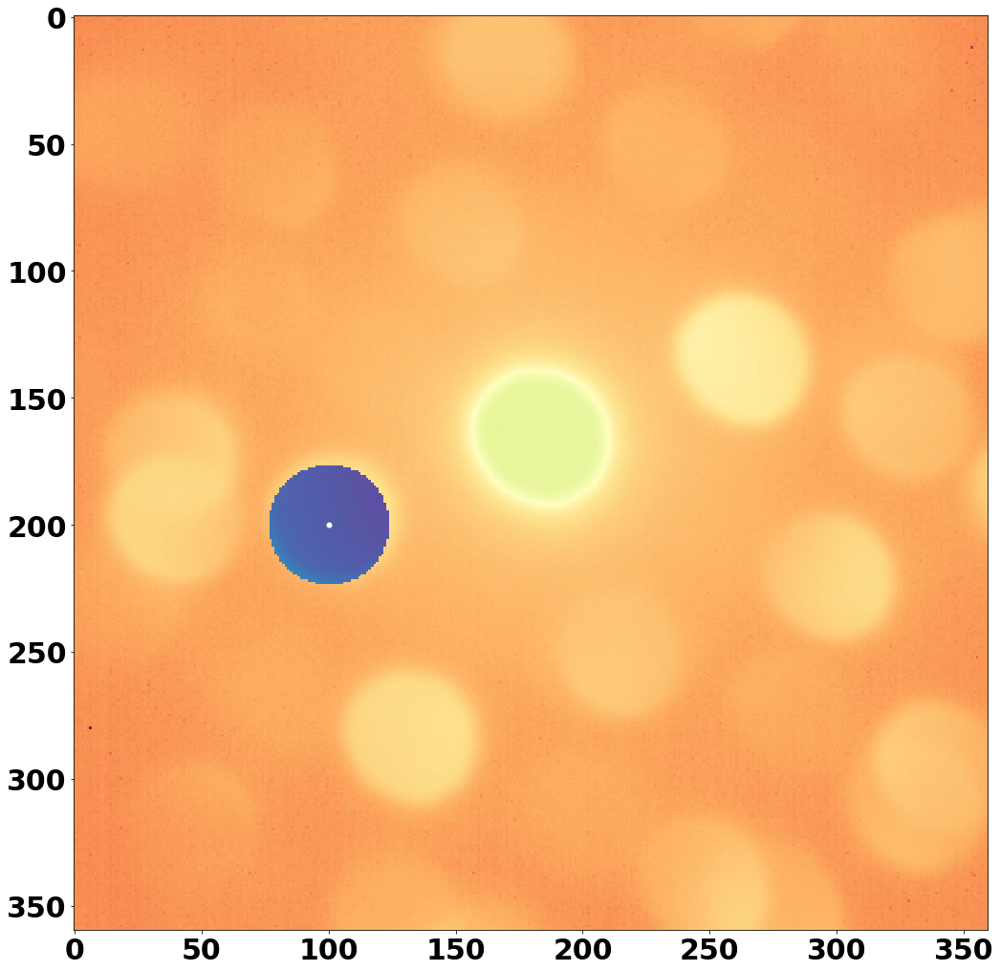

In [110]:
ll_pos = (100,200)
ll_aperture = st.nbed.test_aperture(st.util.image_logarizer(Mean_CBED,16),ll_pos,beam_r)

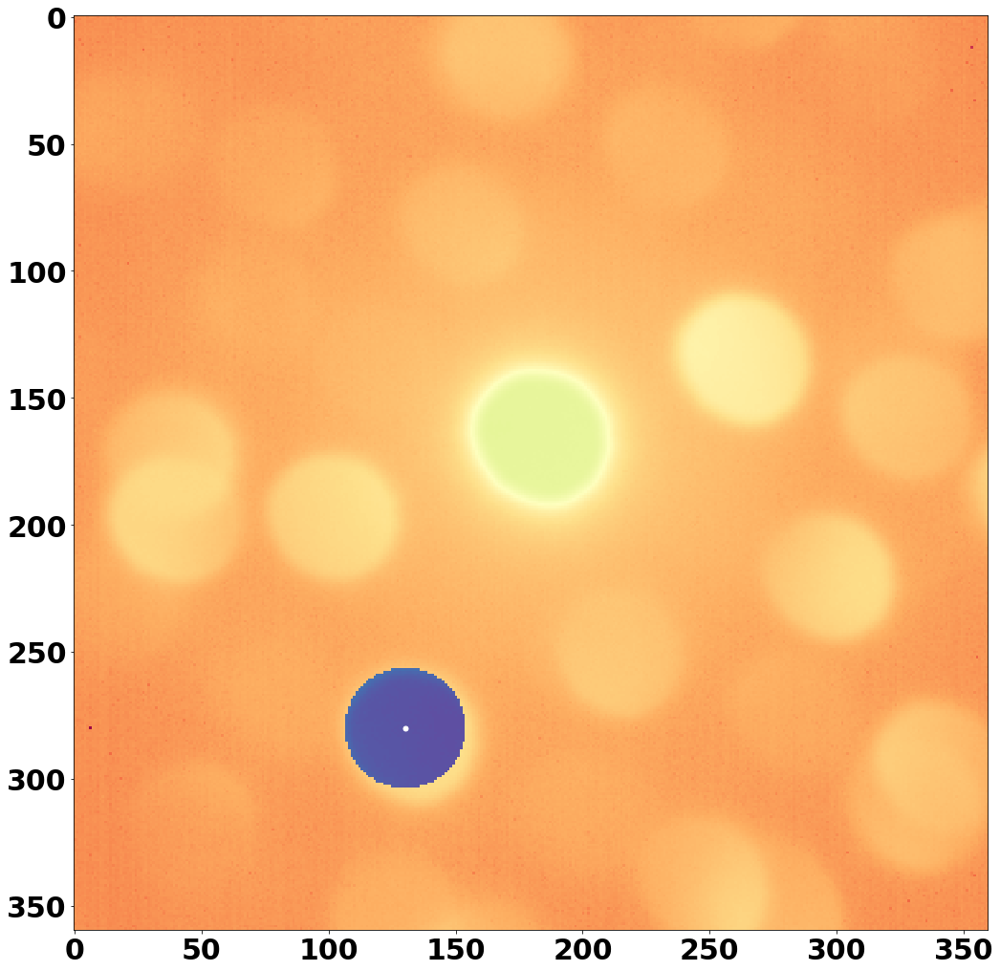

In [111]:
bl_pos = (130,280)
bl_aperture = st.nbed.test_aperture(st.util.image_logarizer(Mean_CBED,16),bl_pos,beam_r)

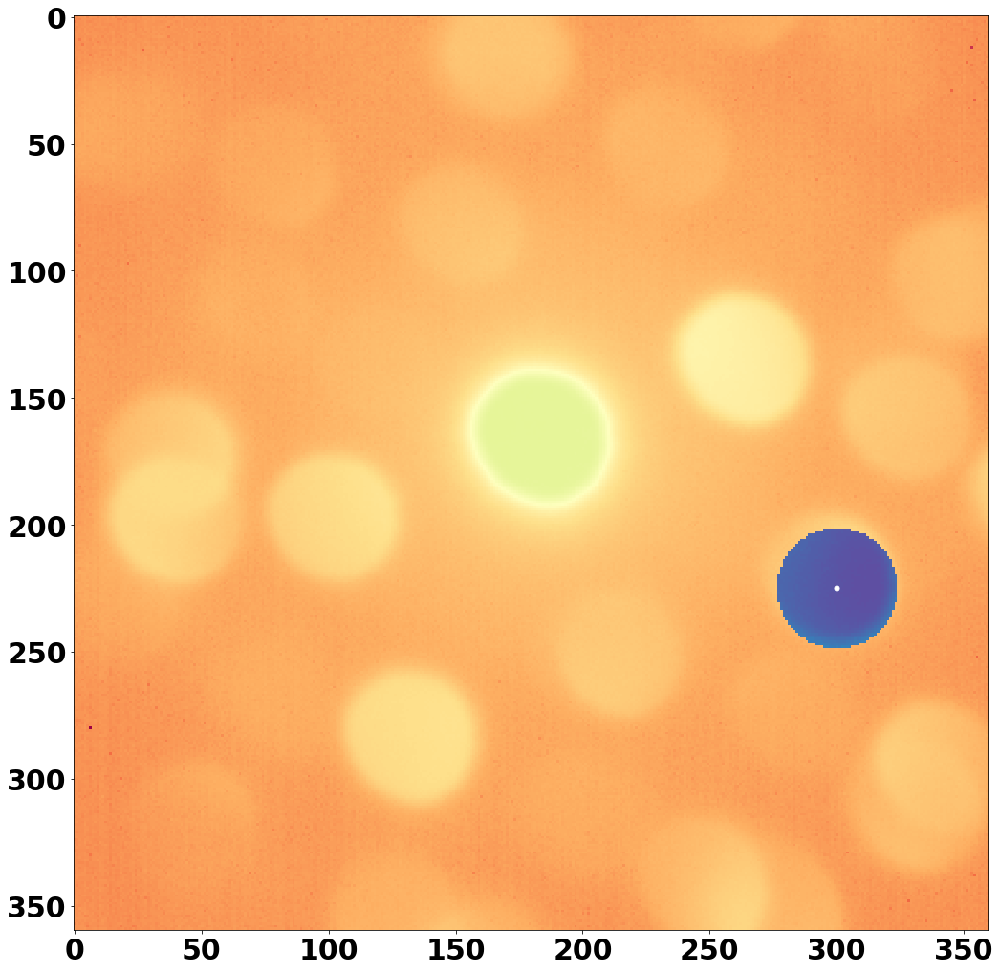

In [112]:
br_pos = (300,225)
br_aperture = st.nbed.test_aperture(st.util.image_logarizer(Mean_CBED,16),br_pos,beam_r)

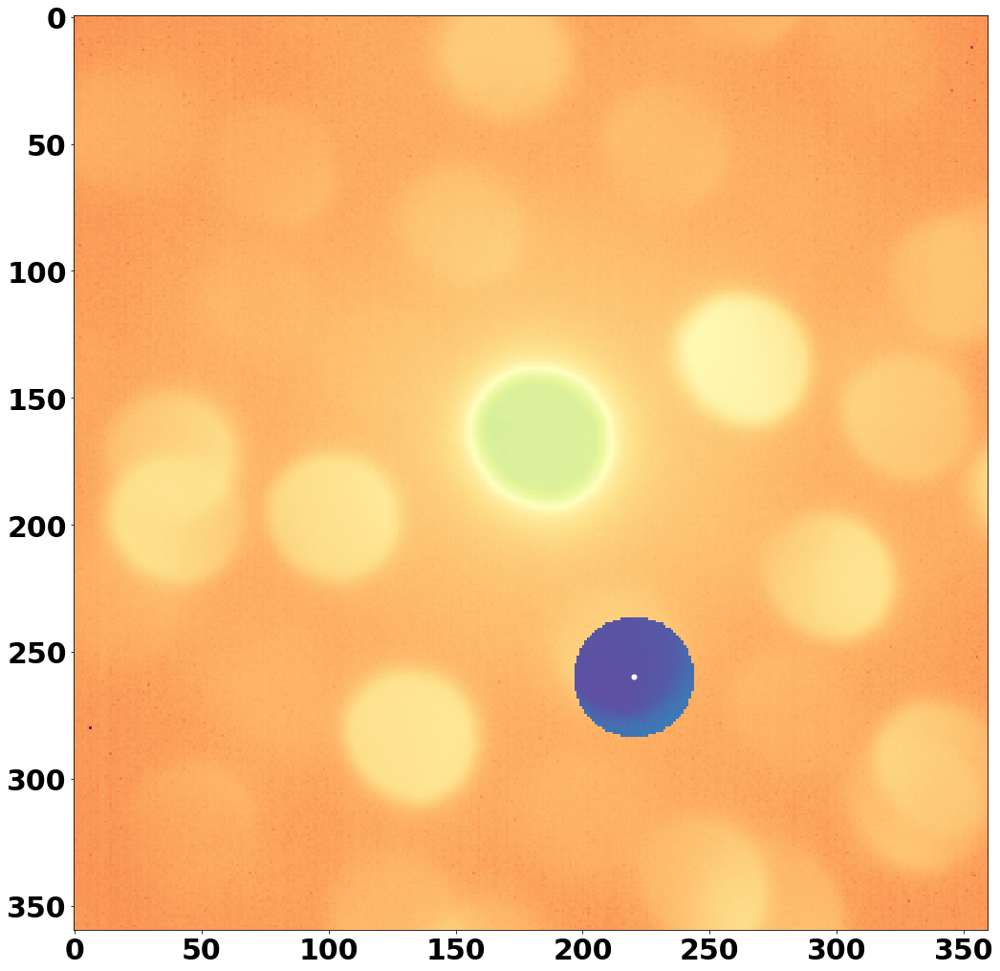

In [113]:
bb_pos = (220,260)
bb_aperture = st.nbed.test_aperture(st.util.image_logarizer(Mean_CBED,16),bb_pos,beam_r)

In [114]:
st.tic()
center_image = st.nbed.aperture_image(strain4D,center_pos,34)
ll_image = st.nbed.aperture_image(strain4D,ll_pos,34)
rr_image = st.nbed.aperture_image(strain4D,rr_pos,34)
bl_image = st.nbed.aperture_image(strain4D,bl_pos,34)
br_image = st.nbed.aperture_image(strain4D,br_pos,34)
bb_image = st.nbed.aperture_image(strain4D,bb_pos,34)
st.toc()

Elapsed time: 93.180672 seconds.



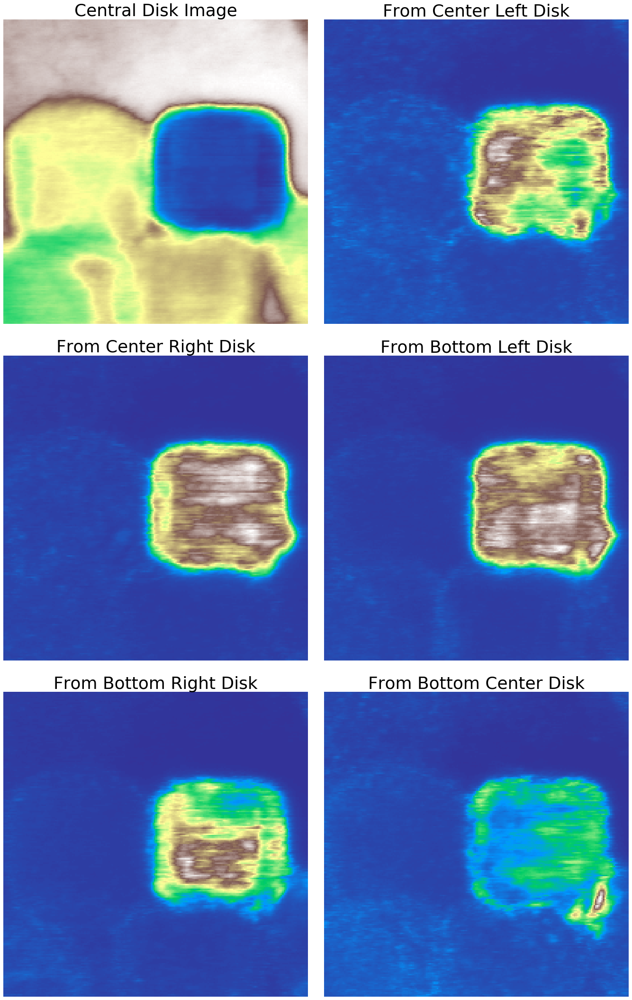

In [115]:
plt.figure(figsize=(20, 30))
plt.subplot(3,2,1)
plt.imshow(center_image,cmap='terrain')
plt.title('Central Disk Image')
plt.axis('off')
plt.subplot(3,2,2)
plt.imshow(ll_image,cmap='terrain')
plt.title('From Center Left Disk')
plt.axis('off')
plt.subplot(3,2,3)
plt.imshow(rr_image,cmap='terrain')
plt.title('From Center Right Disk')
plt.axis('off')
plt.subplot(3,2,4)
plt.imshow(bl_image,cmap='terrain')
plt.title('From Bottom Left Disk')
plt.axis('off')
plt.subplot(3,2,5)
plt.imshow(br_image,cmap='terrain')
plt.title('From Bottom Right Disk')
plt.axis('off')
plt.subplot(3,2,6)
plt.imshow(bb_image,cmap='terrain')
plt.title('From Bottom Center Disk')
plt.axis('off')

plt.tight_layout()
plt.savefig('Results_4D/VirtialApertures.pdf')

We choose the central disk for getting the ROI, as the particle we are interested in is visible the clearest.

In [116]:
yy,xx = np.mgrid[0:strain4D.shape[2],0:strain4D.shape[3]]

In [117]:
ROI_4D = strain4D[:,:,yy[total_ROI],xx[total_ROI]]

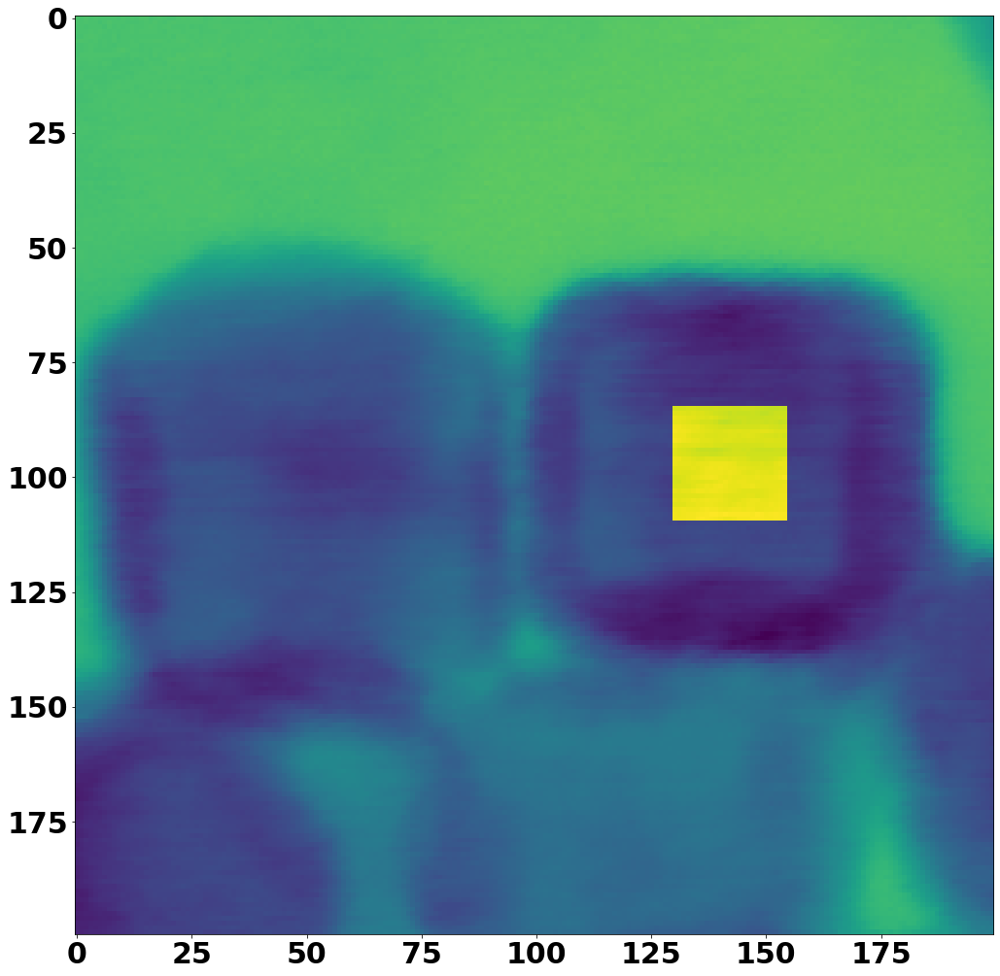

In [118]:
Reference_Region = np.zeros_like(total_ROI)
Reference_Region[85:110,130:155] = True
plt.figure(figsize=(15, 15))
plt.imshow(Reference_Region+st.util.image_normalizer(bf_stem),cmap='viridis')
plt.savefig('Results_4D/Reference_Region.pdf')

In [119]:
Reference_4D = strain4D[:,:,yy[Reference_Region],xx[Reference_Region]]

Text(0.5, 1.0, 'Log of Mean Diffraction Pattern from Reference')

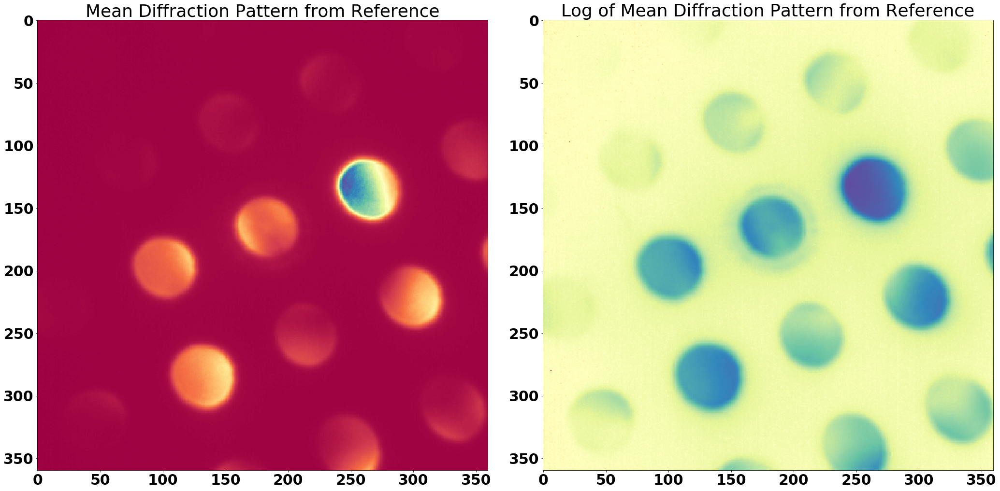

In [120]:
Mean_CBED_Reference = np.mean(Reference_4D,axis=-1,dtype=np.float64)
plt.figure(figsize=(30, 15))
plt.subplot(1,2,1)
plt.imshow(Mean_CBED_Reference,cmap='Spectral')
plt.title('Mean Diffraction Pattern from Reference')
plt.subplot(1,2,2)
plt.imshow(st.util.image_logarizer(Mean_CBED_Reference,16),cmap='Spectral')
plt.title('Log of Mean Diffraction Pattern from Reference')

We plot the mean diffraction pattern, and also go to a region of the dataset where there was no sample and then plot just the beam from there.

Text(0.5, 1.0, 'Cross Correlation of Log-Sobel')

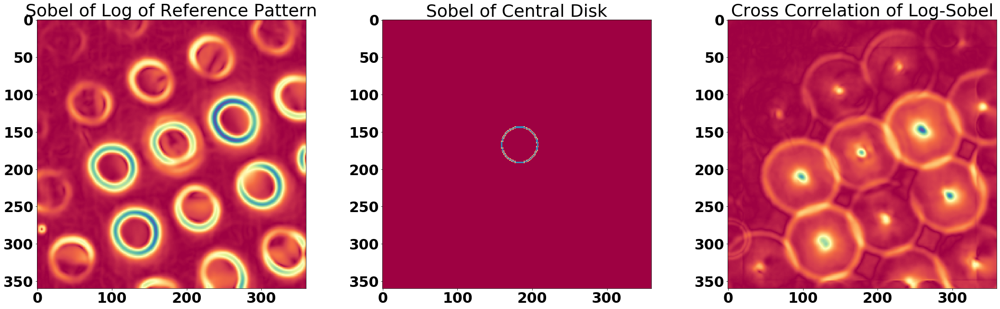

In [124]:
med_val = 20
sobel_center_disk,_ = st.proc.sobel(center_disk)
sobel_lm_cbed,_ = st.proc.sobel(scnd.gaussian_filter(st.util.image_logarizer(Mean_CBED_Reference),3))
sobel_lm_cbed[sobel_lm_cbed > med_val*np.median(sobel_lm_cbed)] = med_val*np.median(sobel_lm_cbed)
sobel_lm_cbed[sobel_lm_cbed < np.median(sobel_lm_cbed)/med_val] = np.median(sobel_lm_cbed)/med_val
lsc_reference = st.util.cross_corr(sobel_lm_cbed,sobel_center_disk,hybridizer=0.25)
plt.figure(figsize=(30, 10))
plt.subplot(1,3,1)
plt.imshow(sobel_lm_cbed,cmap='Spectral')
plt.title('Sobel of Log of Reference Pattern')
plt.subplot(1,3,2)
plt.imshow(sobel_center_disk,cmap='Spectral')
plt.title('Sobel of Central Disk')
plt.subplot(1,3,3)
plt.imshow(lsc_reference,cmap='Spectral')
plt.title('Cross Correlation of Log-Sobel')

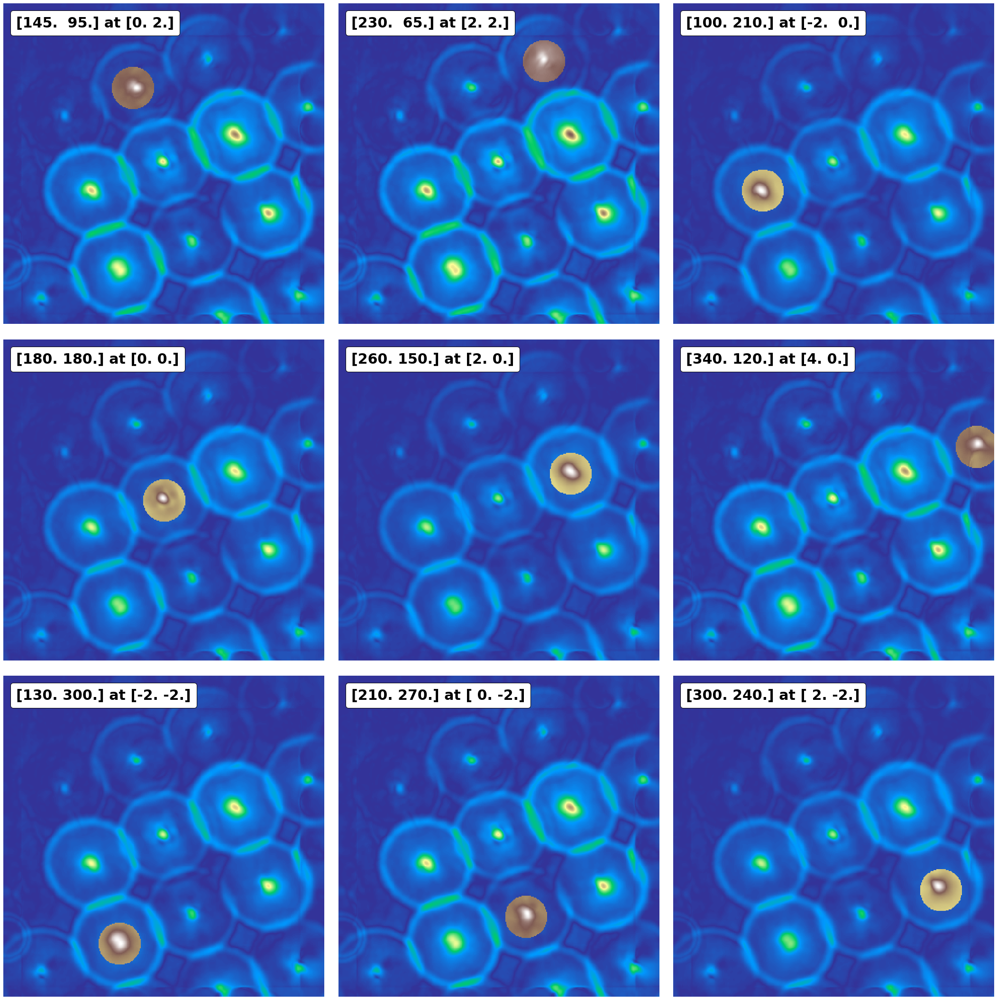

In [127]:
title_font = {'weight': 'bold',
              'size': 30,
             }

disk_pixel_list = np.asarray(((145,95),
                              (230,65),
                              (100,210),
                              (180,180),
                              (260,150),
                              (340,120),
                              (130,300),
                              (210,270),
                              (300,240)),dtype=np.float64)
disk_value_list = np.asarray(((0,2),
                              (2,2),
                              (-2,0),
                              (0,0),
                              (2,0),
                              (4,0),
                              (-2,-2),
                              (0,-2),
                              (2,-2)),dtype=np.float64)
plt.figure(figsize=(30, 30))
for ii in range(9):
    plt.subplot(3,3,ii+1)
    plt.imshow(st.util.image_normalizer(lsc_reference) + 
               st.util.make_circle(lsc_reference.shape,disk_pixel_list[ii,0],disk_pixel_list[ii,1],beam_r),cmap='terrain')
    at = AnchoredText(str(disk_pixel_list[ii,:]) + ' at ' + str(disk_value_list[ii,:]),
                  prop=dict(size=30), frameon=True,
                  loc='upper left',
                  )
    at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    plt.gca().add_artist(at)
    plt.axis('off')
plt.tight_layout()

In [128]:
%timeit st.nbed.fit_nbed_disks(lsc_reference,beam_r,disk_pixel_list,disk_value_list)

142 ms ± 3.54 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [129]:
st.tic()
reference_disk_list,reference_center,std,reference_axes = st.nbed.fit_nbed_disks(lsc_reference,beam_r,disk_pixel_list,disk_value_list,0.5)
_,_,log_std,log_axes = st.nbed.fit_nbed_disks(st.util.image_logarizer(Mean_CBED_Reference),beam_r,disk_pixel_list,disk_value_list)
_,_,raw_std,raw_axes = st.nbed.fit_nbed_disks(Mean_CBED_Reference,beam_r,disk_pixel_list,disk_value_list)
st.toc()

Elapsed time: 0.515794 seconds.



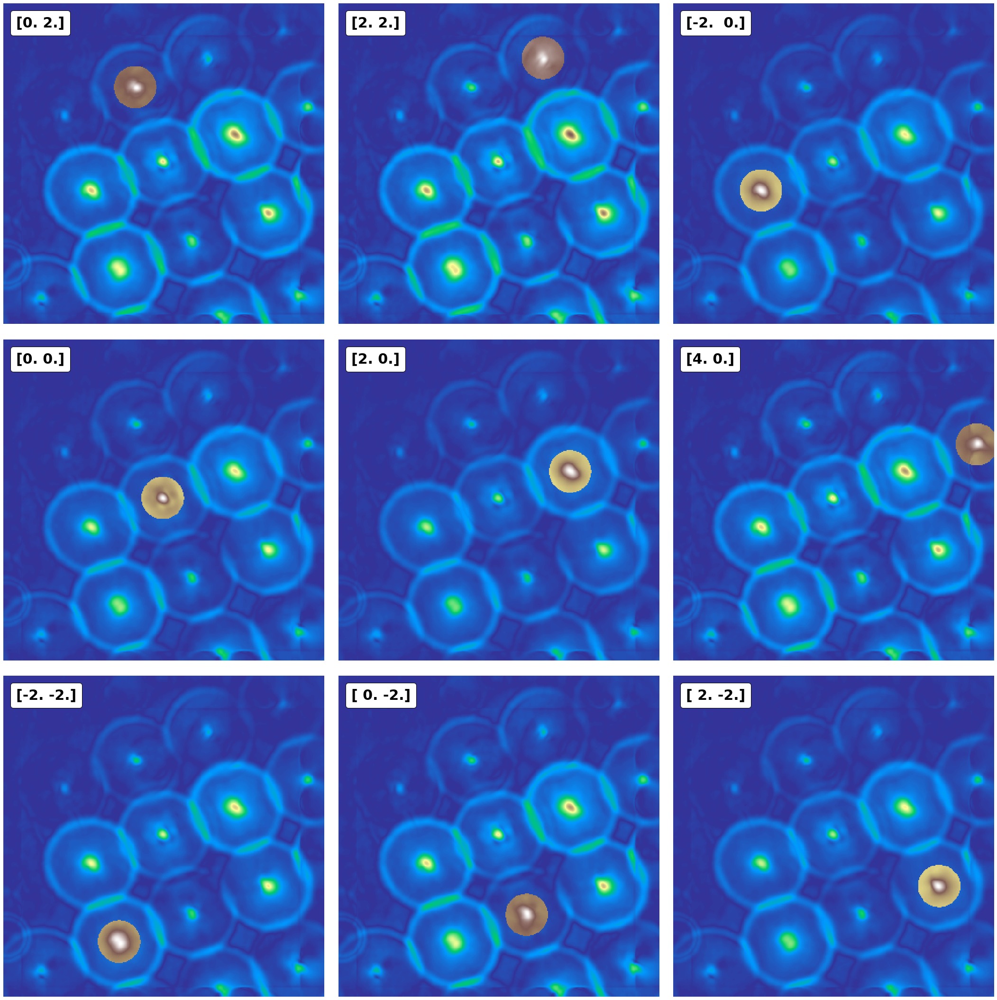

In [130]:
plt.figure(figsize=(30, 30))
for ii in range(9):
    plt.subplot(3,3,ii+1)
    plt.imshow(st.util.image_normalizer(lsc_reference) + 
               st.util.make_circle(lsc_reference.shape,reference_disk_list[ii,0],reference_disk_list[ii,1],beam_r),cmap='terrain')
    at = AnchoredText(str(disk_value_list[ii,:]),
                  prop=dict(size=30), frameon=True,
                  loc='upper left',
                  )
    at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    plt.gca().add_artist(at)
    plt.axis('off')
plt.tight_layout()

In [131]:
err_lsb = np.divide(std,((np.sum((reference_axes ** 2),axis=1)) ** 0.5))
err_log = np.divide(log_std,((np.sum((log_axes ** 2),axis=1)) ** 0.5))
err_raw = np.divide(raw_std,((np.sum((raw_axes ** 2),axis=1)) ** 0.5))
err_lsb,err_log,err_raw

(array([0.00070665, 0.00076594]),
 array([0.00270197, 0.00122175]),
 array([0.00299831, 0.00107515]))

In [132]:
100*np.mean(err_raw),100*np.mean(err_log),100*np.mean(err_lsb)

(0.2036726446520463, 0.19618583127637954, 0.0736290953887409)

In [133]:
platinum_d = 100/392.42
palladium_d = 100/389.07
rhodium_d = 100/380.34
platinum_pos = 1000*st.beam.wavelength_ang(100)*platinum_d
palladium_pos = 1000*st.beam.wavelength_ang(100)*palladium_d
rhodium_pos = 1000*st.beam.wavelength_ang(100)*rhodium_d

In [134]:
mrad_calibration = rhodium_pos/np.mean((np.sum((reference_axes ** 2),axis=1)) ** 0.5)
beam_size = mrad_calibration*beam_r
beam_size

5.112399853958602

In [135]:
inverse_nm_calibration = mrad_calibration/0.1*st.beam.wavelength_ang(100)

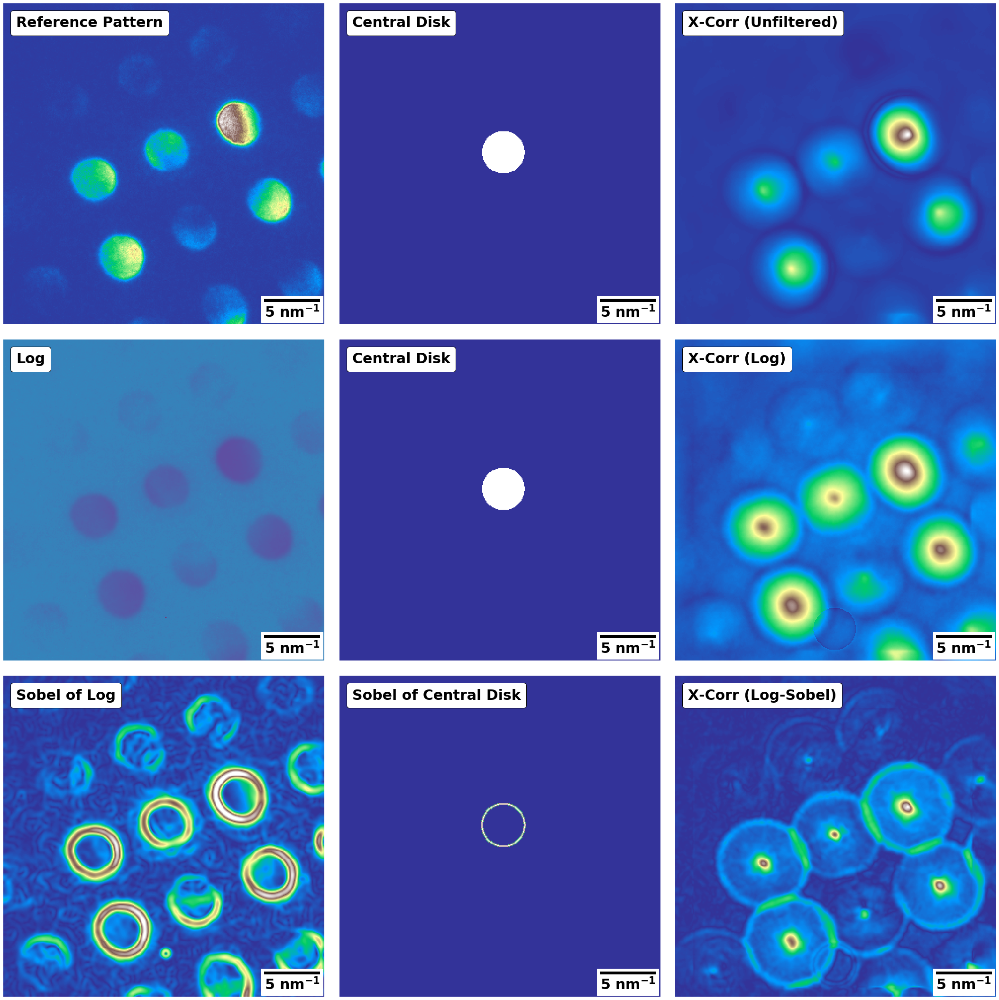

In [136]:
random_cbed = strain4D[:,:,100,140]
log_random_cbed = st.util.image_logarizer(random_cbed)
med_val = 20
sobel_center_disk,_ = st.proc.sobel(center_disk)
sobel_lm_rand,_ = st.proc.sobel(scnd.gaussian_filter(st.util.image_logarizer(random_cbed),3))
sobel_lm_rand[sobel_lm_rand > med_val*np.median(sobel_lm_rand)] = med_val*np.median(sobel_lm_rand)
sobel_lm_rand[sobel_lm_rand < np.median(sobel_lm_rand)/med_val] = np.median(sobel_lm_rand)/med_val
cc_rand = st.util.cross_corr(random_cbed,center_disk,hybridizer=0.25)
lcc_rand = st.util.cross_corr(log_random_cbed,center_disk,hybridizer=0.25)
lsc_rand = st.util.cross_corr(sobel_lm_rand,sobel_center_disk,hybridizer=0.25)

font_size = int(30)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

plt.figure(figsize=(30, 30))

plt.subplot(3,3,1)
plt.imshow(random_cbed,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Reference Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,2)
plt.imshow(center_disk,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Central Disk',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,3)
plt.imshow(cc_rand,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('X-Corr (Unfiltered)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,4)
plt.imshow(log_random_cbed,cmap='Spectral')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Log',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,5)
plt.imshow(center_disk,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Central Disk',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,6)
plt.imshow(lcc_rand,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('X-Corr (Log)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,7)
plt.imshow(sobel_lm_rand,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Sobel of Log',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,8)
plt.imshow(sobel_center_disk,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Sobel of Central Disk',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,9)
plt.imshow(lsc_rand,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('X-Corr (Log-Sobel)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.tight_layout()

plt.tight_layout()
plt.savefig('Results_4D/Filtering_Comparison_Random.pdf',bbox_inches = 'tight')

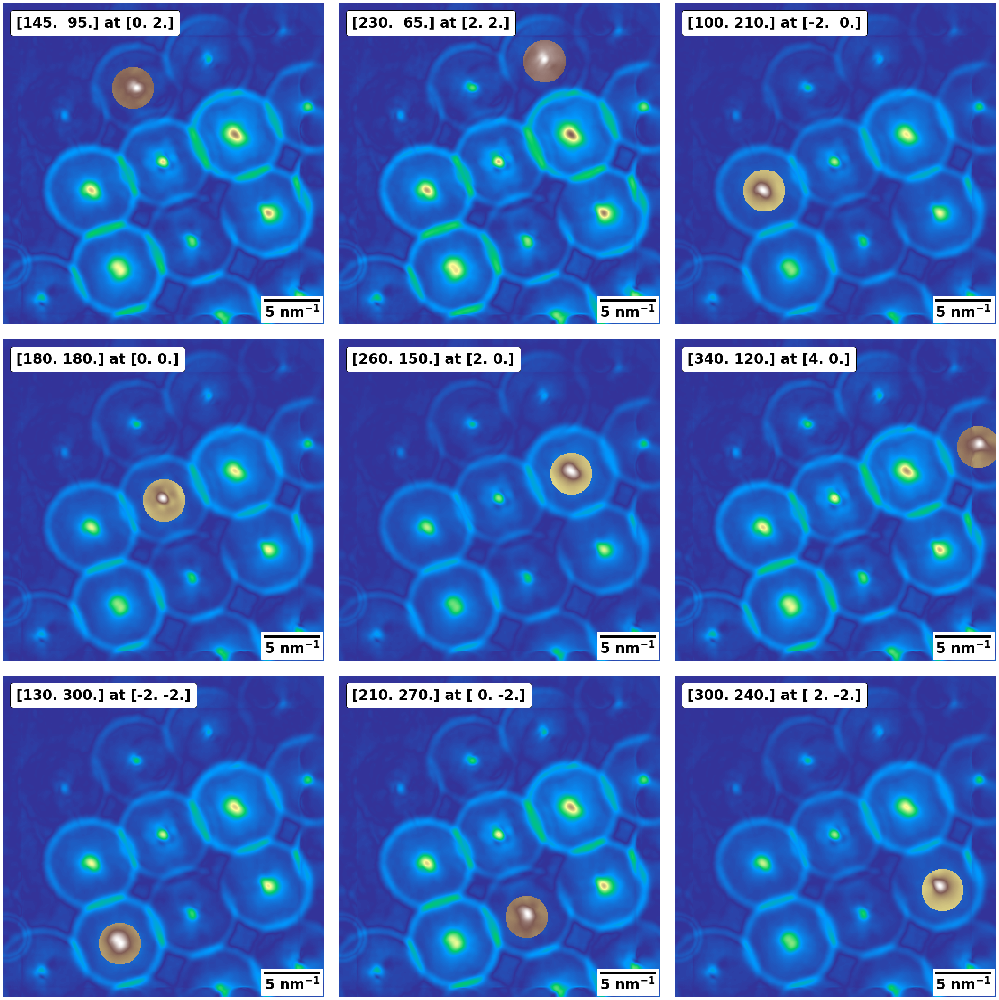

In [137]:
title_font = {'weight': 'bold',
              'size': 30,
             }

disk_pixel_list = np.asarray(((145,95),
                              (230,65),
                              (100,210),
                              (180,180),
                              (260,150),
                              (340,120),
                              (130,300),
                              (210,270),
                              (300,240)),dtype=np.float64)
disk_value_list = np.asarray(((0,2),
                              (2,2),
                              (-2,0),
                              (0,0),
                              (2,0),
                              (4,0),
                              (-2,-2),
                              (0,-2),
                              (2,-2)),dtype=np.float64)
plt.figure(figsize=(30, 30))
for ii in range(9):
    plt.subplot(3,3,ii+1)
    plt.imshow(st.util.image_normalizer(lsc_reference) + 
               st.util.make_circle(lsc_reference.shape,disk_pixel_list[ii,0],disk_pixel_list[ii,1],beam_r),cmap='terrain')
    scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
    scalebar.location = 'lower right'
    scalebar.box_alpha = 1
    scalebar.color = 'k'
    plt.gca().add_artist(scalebar)
    at = AnchoredText(str(disk_pixel_list[ii,:]) + ' at ' + str(disk_value_list[ii,:]),
                  prop=dict(size=30), frameon=True,
                  loc='upper left',
                  )
    at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    plt.gca().add_artist(at)
    plt.axis('off')
plt.tight_layout()
plt.savefig('Results_4D/Initial_disks.pdf',bbox_inches = 'tight')

In [138]:
ROI_small = np.zeros_like(total_ROI)
ROI_small[87:97,130:140] = True

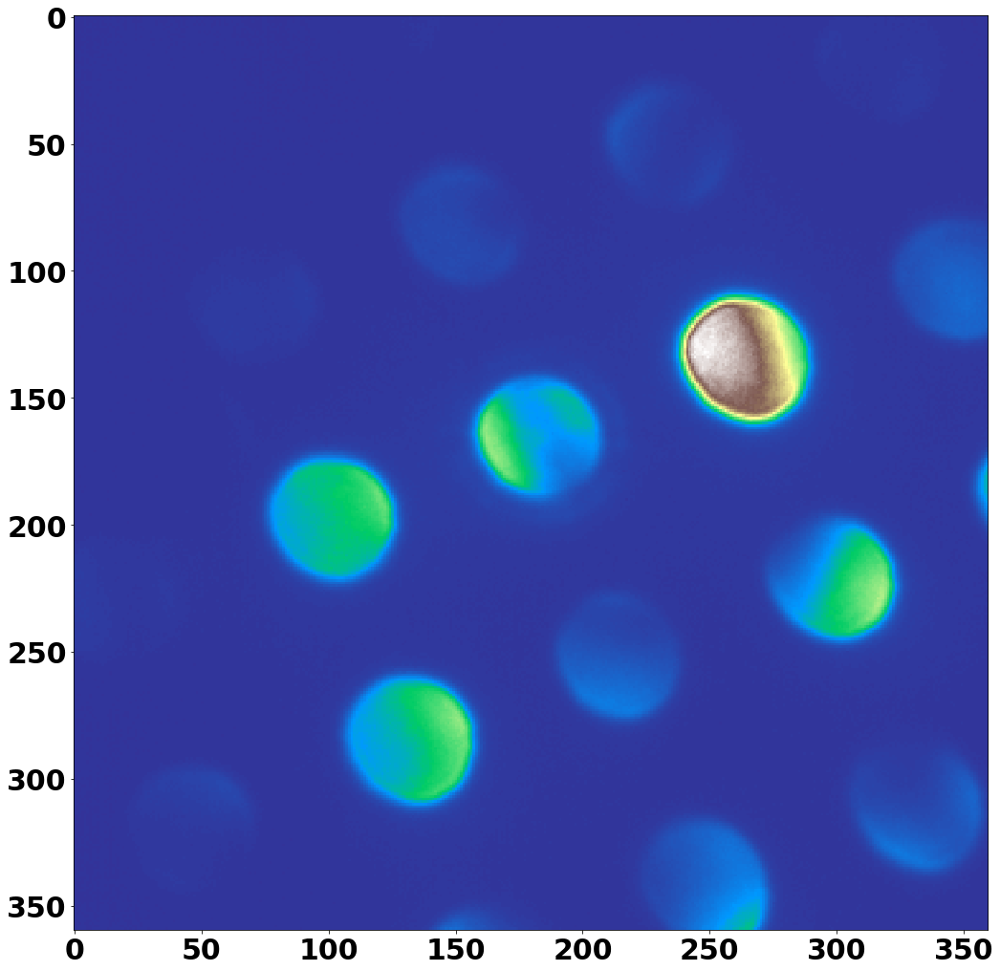

In [139]:
ss = strain4D[:,:,ROI_small]
plt.figure(figsize=(15,15))
plt.imshow(np.mean(ss,axis=-1,dtype=np.float64),cmap='terrain')

In [140]:
np.sum(ROI_small)

100

In [141]:
np.sum(total_ROI)

7939

In [142]:
%timeit st.nbed.strain_in_ROI(strain4D,ROI_small,center_disk,disk_pixel_list,disk_value_list,reference_axes,med_factor=30,nan_cutoff=0.5)

35.6 s ± 545 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [143]:
st.tic()
e_xx_ROI,e_xy_ROI,e_th_ROI,e_yy_ROI,fit_data = st.nbed.strain_in_ROI(strain4D,
                                                                     total_ROI,
                                                                     center_disk,
                                                                     disk_pixel_list,
                                                                     disk_value_list,
                                                                     reference_axes,
                                                                     med_factor=30,
                                                                     nan_cutoff=0.5)
st.toc()

Elapsed time: 3129.120744 seconds.



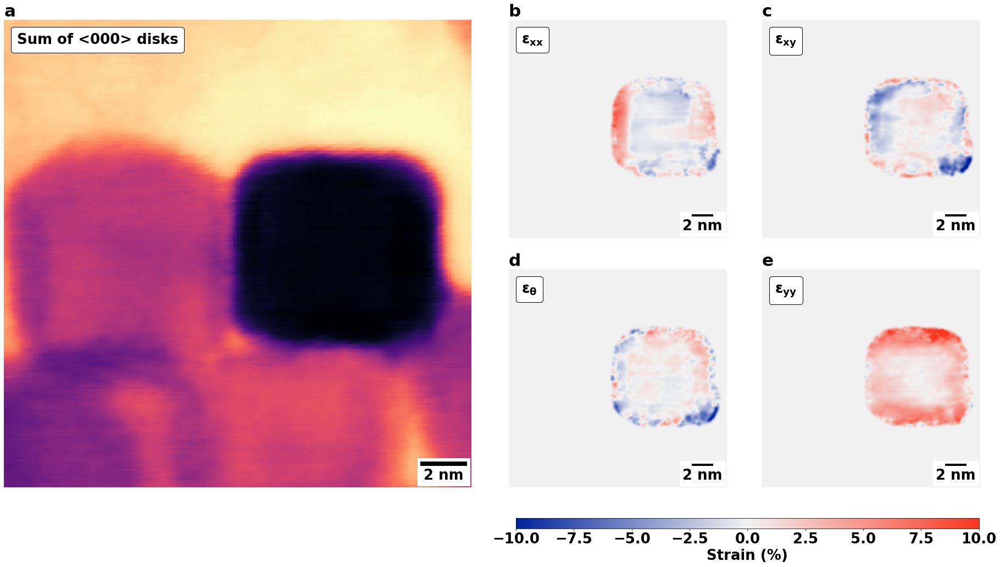

In [180]:
#vm = np.amax(np.abs(np.concatenate((e_xx_ROI,e_xy_ROI,e_th_ROI,e_yy_ROI),axis=1)))
vm = 10
font_size = int(26)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

fig =plt.figure(figsize=(26,13))

gs = mpgs.GridSpec(2, 4)
ax1 = plt.subplot(gs[:, 0:2])
ax2 = plt.subplot(gs[0, 2])
ax3 = plt.subplot(gs[0, 3])
ax4 = plt.subplot(gs[1, 2])
ax5 = plt.subplot(gs[1, 3])

ax1.imshow(center_image,cmap='magma')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax1.axis('off')
at = AnchoredText('Sum of <000> disks',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax1.add_artist(at)
ax1.set_title(label='a',loc='left',fontdict=title_font)
ax1.add_artist(scalebar)

im = ax2.imshow(100*e_xx_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax2.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xx}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax2.add_artist(at)
ax2.set_title(label='b',loc='left',fontdict=title_font)
ax2.axis('off')


im = ax3.imshow(100*e_xy_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax3.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax3.add_artist(at)
ax3.set_title(label='c',loc='left',fontdict=title_font)
ax3.axis('off')


im = ax4.imshow(100*e_th_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax4.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{\theta}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax4.add_artist(at)
ax4.set_title(label='d',loc='left',fontdict=title_font)
ax4.axis('off')


im = ax5.imshow(100*e_yy_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax5.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{yy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax5.add_artist(at)
ax5.set_title(label='e',loc='left',fontdict=title_font)
ax5.axis('off')

p4 = ax4.get_position().get_points().flatten()
p5 = ax5.get_position().get_points().flatten()

ax_cbar = fig.add_axes([p4[0] - 0.005, -0.05, 0.5*p5[2], 0.02])
cbar = plt.colorbar(im, cax=ax_cbar, orientation='horizontal')
cbar.set_label('Strain (%)',**sc_font)

plt.tight_layout()
plt.savefig('Results_4D/Particle1_Strain.pdf',bbox_inches = 'tight')

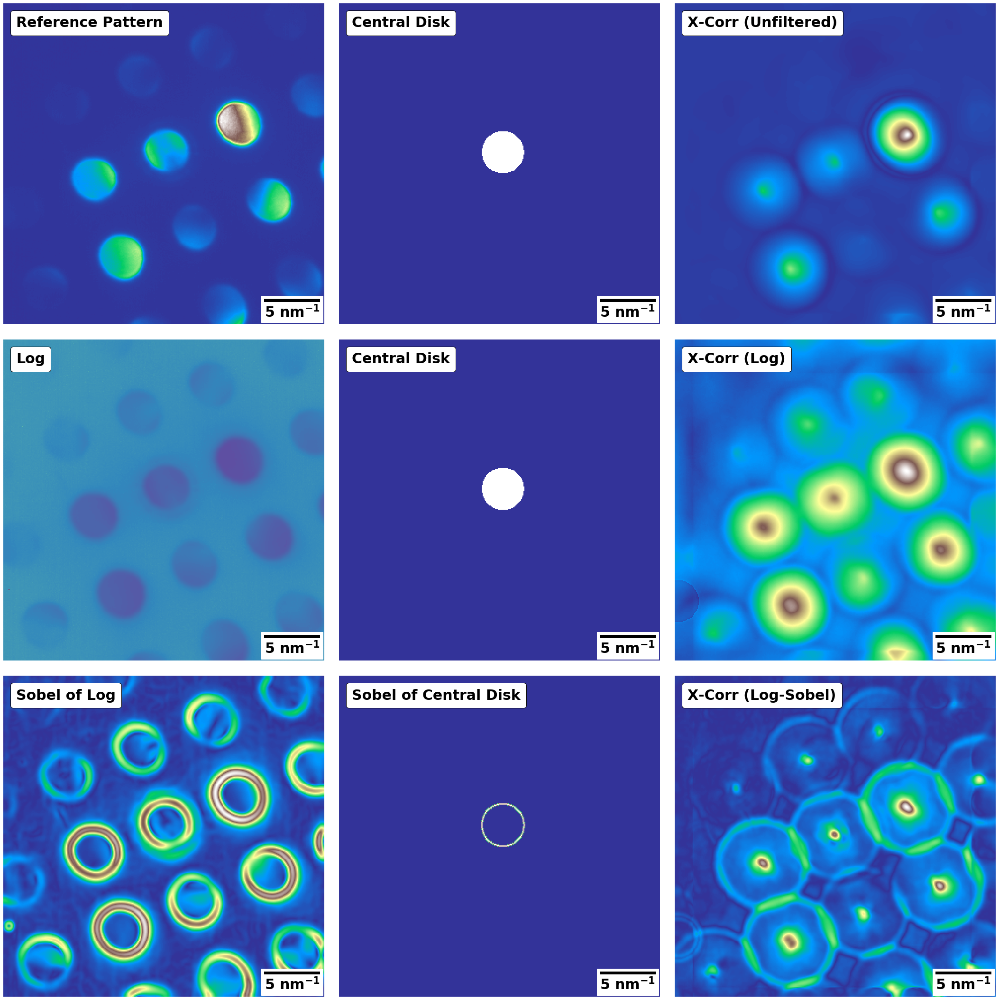

In [146]:
cc_ref = st.util.cross_corr(Mean_CBED_Reference,center_disk,hybridizer=0.25)
lcc_ref = st.util.cross_corr(st.util.image_logarizer(Mean_CBED_Reference),center_disk,hybridizer=0.25)
font_size = int(30)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

plt.figure(figsize=(30, 30))

plt.subplot(3,3,1)
plt.imshow(Mean_CBED_Reference,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Reference Pattern',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,2)
plt.imshow(center_disk,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Central Disk',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,3)
plt.imshow(cc_ref,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('X-Corr (Unfiltered)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,4)
plt.imshow(st.util.image_logarizer(Mean_CBED_Reference),cmap='Spectral')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Log',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,5)
plt.imshow(center_disk,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Central Disk',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,6)
plt.imshow(lcc_ref,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('X-Corr (Log)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,7)
plt.imshow(sobel_lm_cbed,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Sobel of Log',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,8)
plt.imshow(sobel_center_disk,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('Sobel of Central Disk',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.subplot(3,3,9)
plt.imshow(lsc_reference,cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
plt.gca().add_artist(scalebar)
at = AnchoredText('X-Corr (Log-Sobel)',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
plt.gca().add_artist(at)
plt.axis('off')

plt.tight_layout()
plt.savefig('Results_4D/Filtering_Comparison_Ref.pdf',bbox_inches = 'tight')

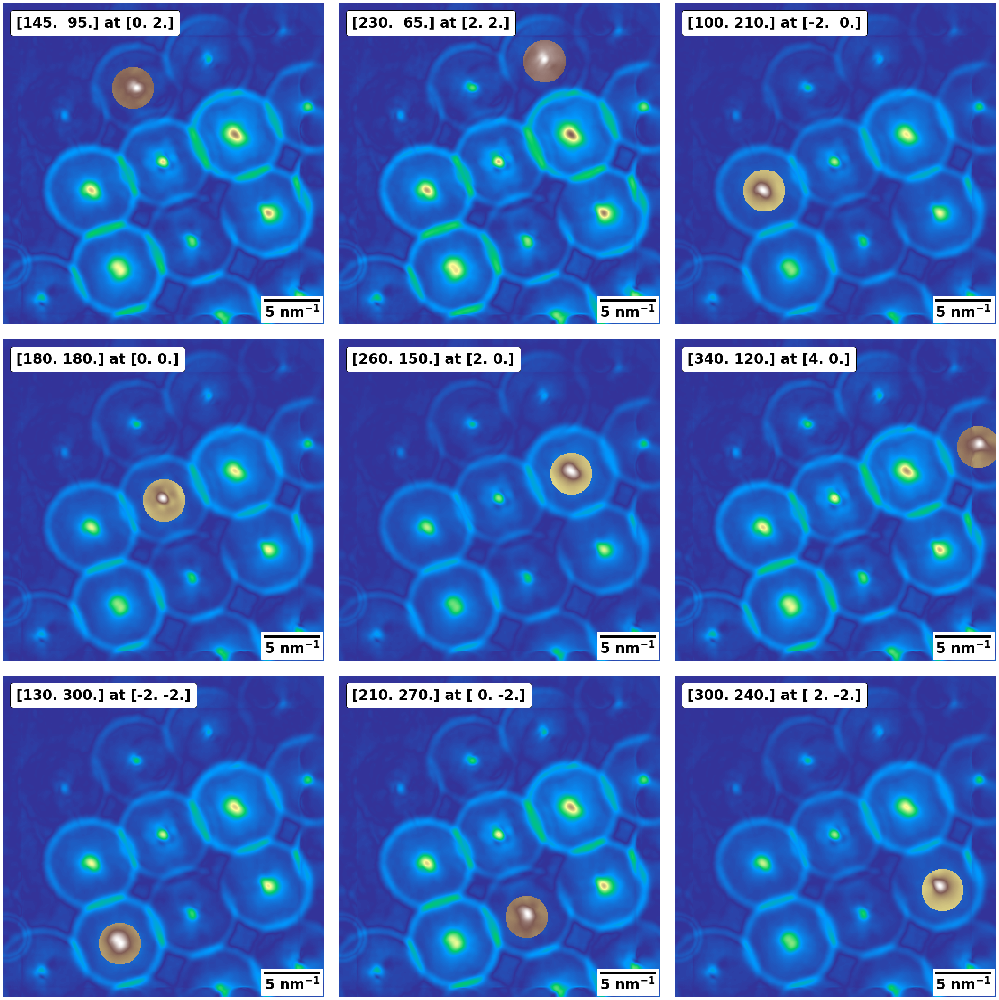

In [147]:
font_size = int(30)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

disk_pixel_list = np.asarray(((145,95),
                              (230,65),
                              (100,210),
                              (180,180),
                              (260,150),
                              (340,120),
                              (130,300),
                              (210,270),
                              (300,240)),dtype=np.float64)
disk_value_list = np.asarray(((0,2),
                              (2,2),
                              (-2,0),
                              (0,0),
                              (2,0),
                              (4,0),
                              (-2,-2),
                              (0,-2),
                              (2,-2)),dtype=np.float64)
plt.figure(figsize=(30, 30))
for ii in range(9):
    plt.subplot(3,3,ii+1)
    plt.imshow(st.util.image_normalizer(lsc_reference) + 
               st.util.make_circle(lsc_reference.shape,disk_pixel_list[ii,0],disk_pixel_list[ii,1],beam_r),cmap='terrain')
    scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
    scalebar.location = 'lower right'
    scalebar.box_alpha = 1
    scalebar.color = 'k'
    plt.gca().add_artist(scalebar)
    at = AnchoredText(str(disk_pixel_list[ii,:]) + ' at ' + str(disk_value_list[ii,:]),
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
    at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    plt.gca().add_artist(at)
    plt.axis('off')
plt.tight_layout()
plt.savefig('Results_4D/Initial_disks.pdf',bbox_inches = 'tight')

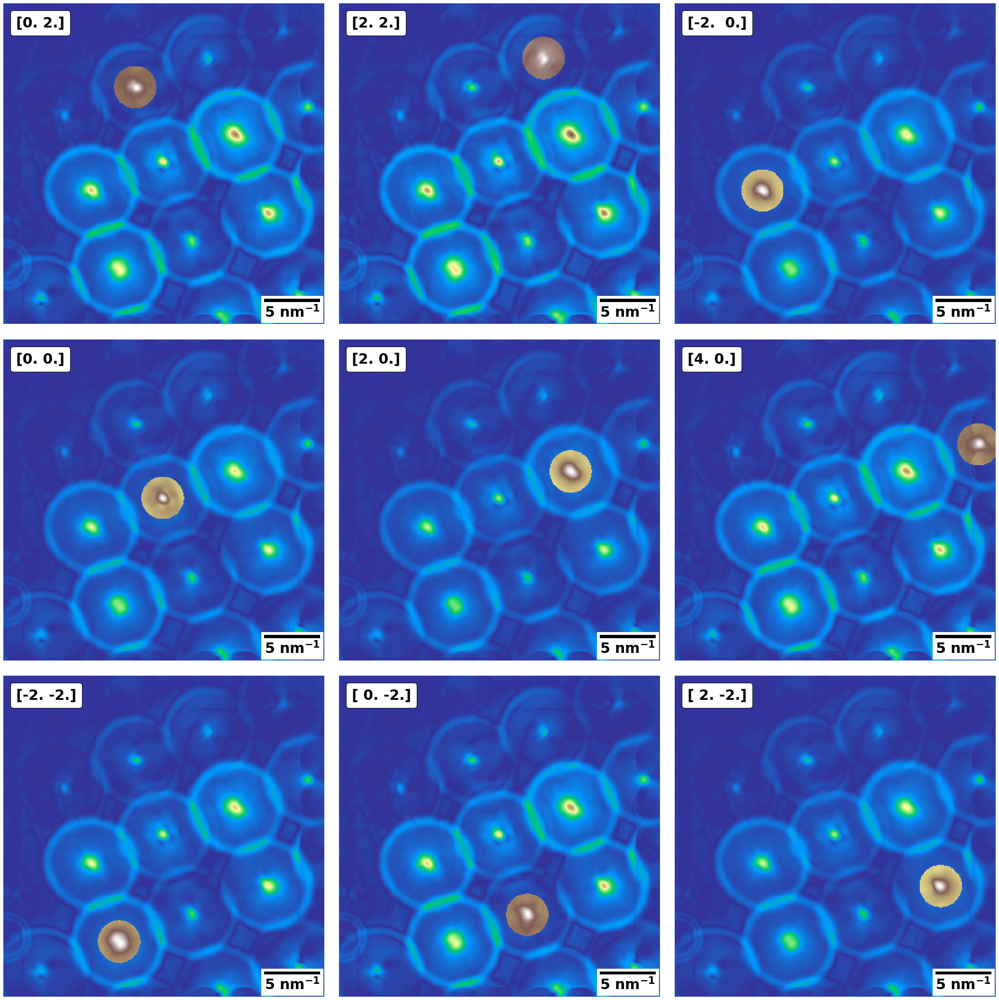

In [148]:
font_size = int(30)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

plt.figure(figsize=(30, 30))
for ii in range(9):
    plt.subplot(3,3,ii+1)
    plt.imshow(st.util.image_normalizer(lsc_reference) + 
               st.util.make_circle(lsc_reference.shape,reference_disk_list[ii,0],reference_disk_list[ii,1],beam_r),cmap='terrain')
    scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
    scalebar.location = 'lower right'
    scalebar.box_alpha = 1
    scalebar.color = 'k'
    plt.gca().add_artist(scalebar)
    at = AnchoredText(str(disk_value_list[ii,:]),
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
    at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    plt.gca().add_artist(at)
    plt.axis('off')
plt.tight_layout()
plt.savefig('Results_4D/Fitted_Disks.pdf',bbox_inches = 'tight')

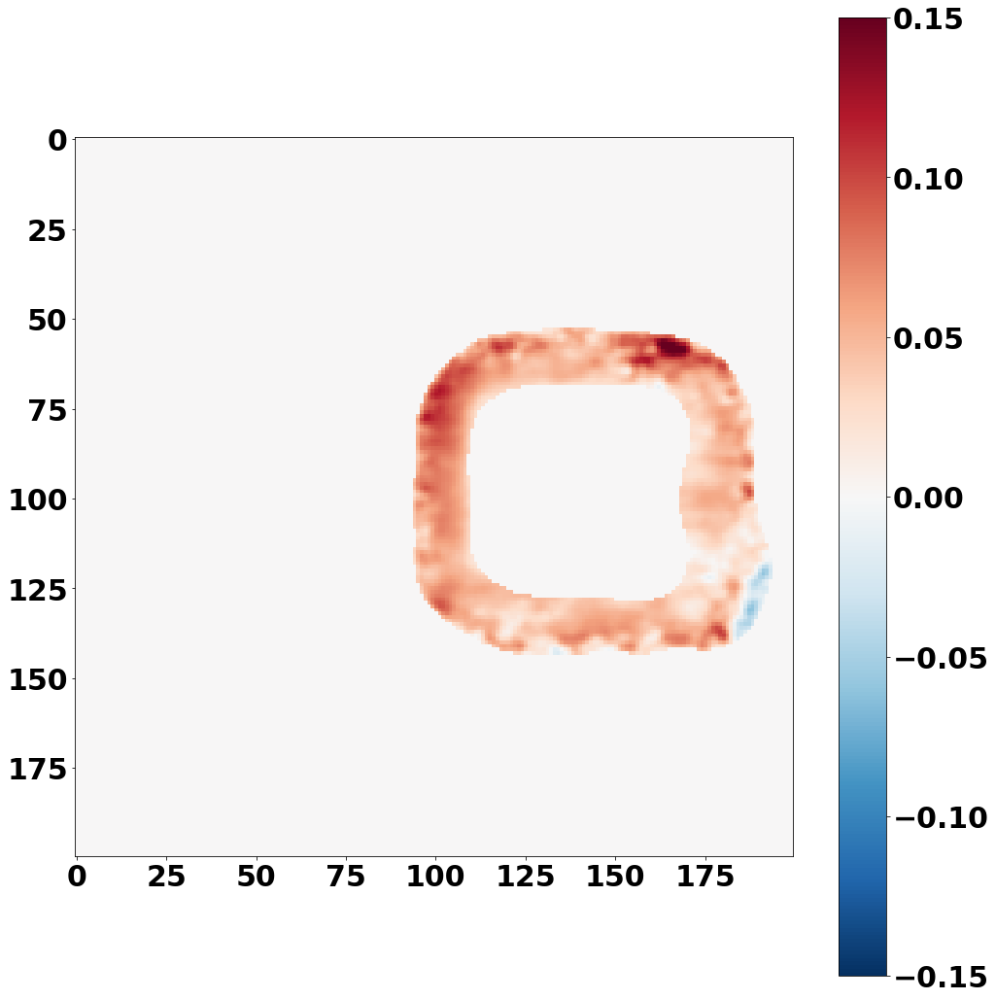

In [149]:
plt.figure(figsize=(15,15))
plt.imshow((((1+e_xx_ROI)*(1+e_yy_ROI)) - 1)*shell_ROI.astype(np.float64),vmin=-0.15,vmax=0.15,cmap="RdBu_r")
plt.colorbar()

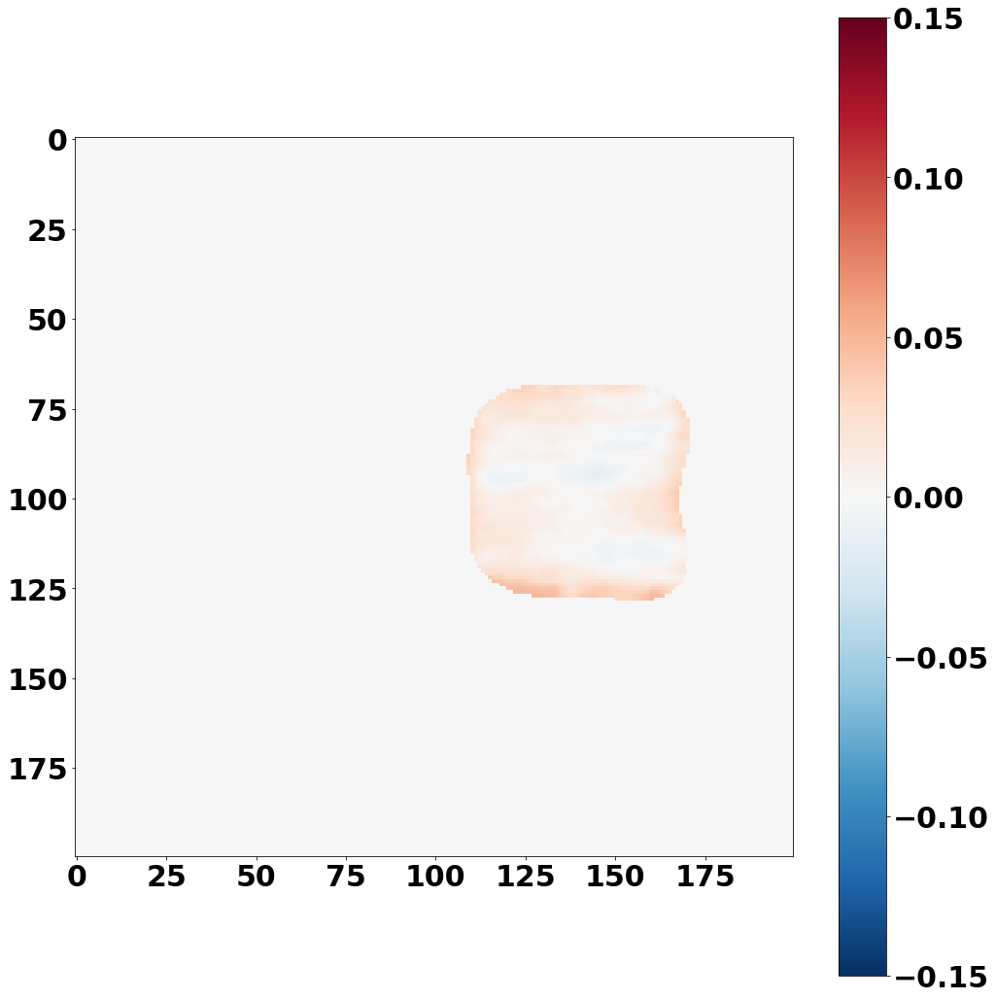

In [150]:
plt.figure(figsize=(15,15))
plt.imshow((((1+e_xx_ROI)*(1+e_yy_ROI)) - 1)*core_ROI.astype(np.float64),vmin=-0.15,vmax=0.15,cmap="RdBu_r")
plt.colorbar()

In [151]:
UC_ratio = ((1+e_xx_ROI)*(1+e_yy_ROI)) - 1
yV, xV = np.mgrid[0:e_xx_ROI.shape[0],0:e_xx_ROI.shape[1]]
yCore = (yV[core_ROI]).astype(np.float64)
xCore = (xV[core_ROI]).astype(np.float64)
yShell = (yV[shell_ROI]).astype(np.float64)
xShell = (xV[shell_ROI]).astype(np.float64)
Core_UC = UC_ratio[core_ROI]
Shell_UC = UC_ratio[shell_ROI]
interface_positions_y = (yV[core_shell_interface]).astype(np.float64)
interface_positions_x = (xV[core_shell_interface]).astype(np.float64)
Core_dist = np.zeros_like(xCore)
Shell_dist = np.zeros_like(xShell)
for ii in np.arange(np.size(xCore)):
    Core_dist[ii] = (-1)*scan_calib_vals*np.amin((((interface_positions_y - yCore[ii]) ** 2) + ((interface_positions_x - xCore[ii]) ** 2)) ** 0.5)
for jj in np.arange(np.size(xShell)):
    Shell_dist[jj] = scan_calib_vals*np.amin((((interface_positions_y - yShell[jj]) ** 2) + ((interface_positions_x - xShell[jj]) ** 2)) ** 0.5)
Shell_dist = Shell_dist - np.amin(Shell_dist)
Core_dist = Core_dist - np.amax(Core_dist)

Text(0, 0.5, 'Deviation from reference unit cell size')

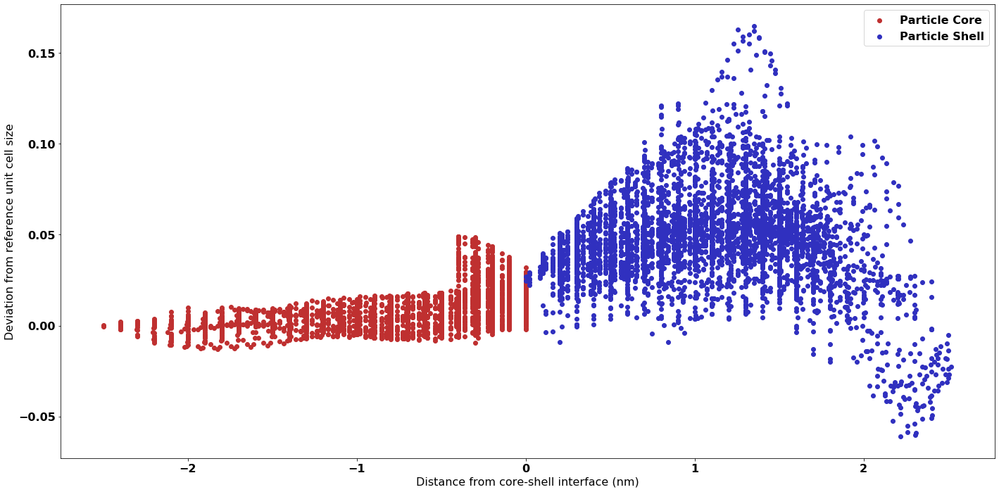

In [197]:
c1 = np.zeros((1,3))
c1[0,:] = np.asarray((256,64,64))
c1 = 0.75*(c1/256)
c2 = np.zeros((1,3))
c2[0,:] = np.asarray((64,64,256))
c2 = 0.75*(c2/256)

plt.figure(figsize=(20,10))
plt.scatter(Core_dist,Core_UC,c=c1,label='Particle Core')
plt.scatter(Shell_dist,Shell_UC,c=c2,label='Particle Shell')
plt.legend(loc='upper right',frameon=True)
plt.xlabel('Distance from core-shell interface (nm)')
plt.ylabel('Deviation from reference unit cell size')

In [153]:
def get_mean_std(xlist,ylist,resolution=25,style='mean'):
    xround = np.copy(xlist)
    xround = np.round(resolution*xround)/resolution
    x_points = int((np.amax(xround) - np.amin(xround))/(1/resolution))
    stdvals = np.zeros((x_points+1,3),dtype=np.float64)
    for ii in np.arange(x_points+1):
        ccval = np.amin(xround) + ii/resolution
        stdvals[ii,0] = ccval
        if (style == 'median'):
            stdvals[ii,1] = np.median(ylist[xround == ccval])
        else:
            stdvals[ii,1] = np.mean(ylist[xround == ccval])
        n_values = np.size(ylist[xround == ccval])
        if (n_values > 0):
            stdvals[ii,2] = np.std(ylist[xround == ccval])/(n_values ** 0.5)
        else:
            stdvals[ii,2] = np.std(ylist[xround == ccval])
    stdvals = stdvals[~np.isnan(stdvals[:,2]),:]
    return stdvals

In [154]:
core_vals = get_mean_std(Core_dist,Core_UC,25,'median')
shell_vals = get_mean_std(Shell_dist,Shell_UC,25,'median')

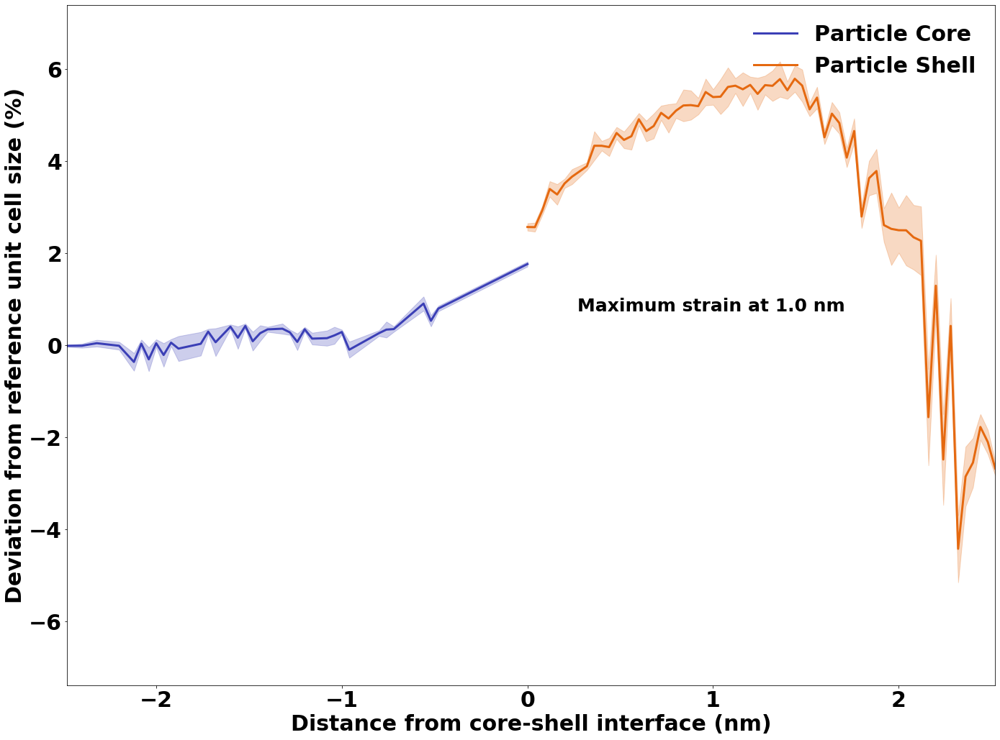

In [155]:
ymax = np.amax((np.amax((np.abs(core_vals[:,1]) + core_vals[:,2])),np.amax((np.abs(shell_vals[:,1]) + shell_vals[:,2]))))
max_string = 'Maximum strain at ' + str(np.round(1*(shell_vals[shell_vals[:,1] == np.amax(shell_vals[:,1]),0][0]))) + ' nm'
plt.figure(figsize=(20,15))
plt.plot(core_vals[:,0],100*core_vals[:,1],c='#3B3FB6',linewidth=3,label='Particle Core')
plt.fill_between(core_vals[:,0], 100*(core_vals[:,1]-core_vals[:,2]), 100*(core_vals[:,1]+core_vals[:,2]),color='#3B3FB6',alpha=0.25)
plt.plot(shell_vals[:,0],100*shell_vals[:,1],c='#E56910',linewidth=3,label='Particle Shell')
plt.fill_between(shell_vals[:,0], 100*(shell_vals[:,1]-shell_vals[:,2]), 100*(shell_vals[:,1]+shell_vals[:,2]),color='#E56910',alpha=0.25)
plt.legend(loc='upper right',frameon=False)
plt.xlim(np.amin(core_vals[:,0]),np.amax(shell_vals[:,0]))
plt.ylim(-120*ymax,120*ymax)
plt.xlabel('Distance from core-shell interface (nm)',fontsize='medium',fontweight='bold')
plt.ylabel('Deviation from reference unit cell size (%)',fontsize='medium',fontweight='bold')
plt.annotate(max_string, (0.55, 0.55), textcoords='axes fraction', size=25)
plt.savefig('Results_4D/UCsizeInterface.pdf',bbox_inches = 'tight')
del ymax

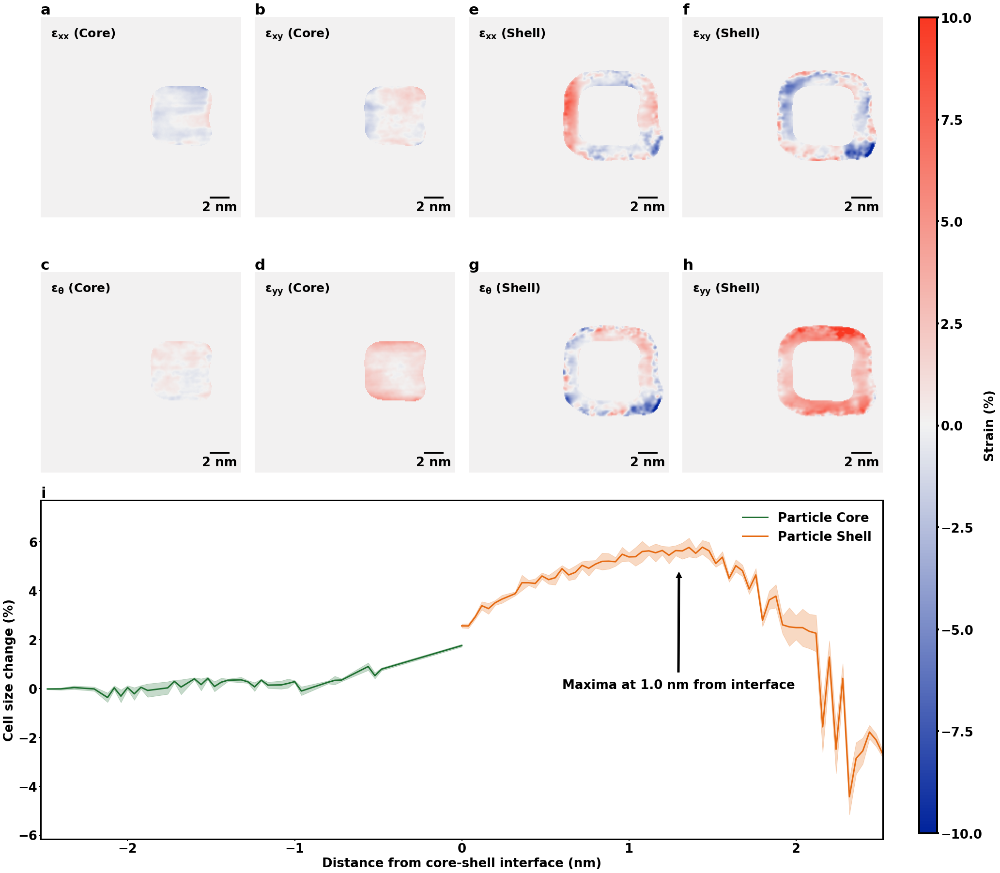

In [179]:
vm = 10
plot_lim = np.amax((np.abs(np.amin(core_vals[:,0])),np.abs(np.amax(shell_vals[:,0]))))
font_size = int(26)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }
ymax = np.amax((np.amax((np.abs(core_vals[:,1]) + core_vals[:,2])),np.amax((np.abs(shell_vals[:,1]) + shell_vals[:,2]))))
max_string = 'Maxima at ' + str(np.round(1*(shell_vals[shell_vals[:,1] == np.amax(shell_vals[:,1]),0][0]))) + ' nm from interface'

fig =plt.figure(figsize=(26,26),constrained_layout=True)

gs = mpgs.GridSpec(3, 4,height_ratios=[0.75,0.75,1],width_ratios=[1,1,1,1])
ax1 = plt.subplot(gs[0, 0])
ax2 = plt.subplot(gs[0, 1])
ax3 = plt.subplot(gs[1, 0])
ax4 = plt.subplot(gs[1, 1])
ax5 = plt.subplot(gs[0, 2])
ax6 = plt.subplot(gs[0, 3])
ax7 = plt.subplot(gs[1, 2])
ax8 = plt.subplot(gs[1, 3])
ax9 = fig.add_subplot(gs[2,:])

im = ax1.imshow(core_ROI*e_xx_ROI*100,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax1.add_artist(scalebar)
ax1.annotate(r'$\mathrm{\epsilon_{xx}}$ (Core)', (0.05, 0.9), textcoords='axes fraction', size=25)
ax1.set_title(label='a',loc='left',fontdict=title_font)
ax1.axis('off')


im = ax2.imshow(core_ROI*e_xy_ROI*100,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax2.add_artist(scalebar)
ax2.annotate(r'$\mathrm{\epsilon_{xy}}$ (Core)', (0.05, 0.9), textcoords='axes fraction', size=25)
ax2.set_title(label='b',loc='left',fontdict=title_font)
ax2.axis('off')


im = ax3.imshow(core_ROI*e_th_ROI*100,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax3.add_artist(scalebar)
ax3.annotate(r'$\mathrm{\epsilon_{\theta}}$ (Core)', (0.05, 0.9), textcoords='axes fraction', size=25)
ax3.set_title(label='c',loc='left',fontdict=title_font)
ax3.axis('off')


im = ax4.imshow(core_ROI*e_yy_ROI*100,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax4.add_artist(scalebar)
ax4.annotate(r'$\mathrm{\epsilon_{yy}}$ (Core)', (0.05, 0.9), textcoords='axes fraction', size=25)
ax4.set_title(label='d',loc='left',fontdict=title_font)
ax4.axis('off')

im = ax5.imshow(shell_ROI*e_xx_ROI*100,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax5.add_artist(scalebar)
ax5.annotate(r'$\mathrm{\epsilon_{xx}}$ (Shell)', (0.05, 0.9), textcoords='axes fraction', size=25)
ax5.set_title(label='e',loc='left',fontdict=title_font)
ax5.axis('off')


im = ax6.imshow(shell_ROI*e_xy_ROI*100,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax6.add_artist(scalebar)
ax6.annotate(r'$\mathrm{\epsilon_{xy}}$ (Shell)', (0.05, 0.9), textcoords='axes fraction', size=25)
ax6.set_title(label='f',loc='left',fontdict=title_font)
ax6.axis('off')


im = ax7.imshow(shell_ROI*e_th_ROI*100,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax7.add_artist(scalebar)
ax7.annotate(r'$\mathrm{\epsilon_{\theta}}$ (Shell)', (0.05, 0.9), textcoords='axes fraction', size=25)
ax7.set_title(label='g',loc='left',fontdict=title_font)
ax7.axis('off')


im = ax8.imshow(shell_ROI*e_yy_ROI*100,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax8.add_artist(scalebar)
ax8.annotate(r'$\mathrm{\epsilon_{yy}}$ (Shell)', (0.05, 0.9), textcoords='axes fraction', size=25)
ax8.set_title(label='h',loc='left',fontdict=title_font)
ax8.axis('off')

p4 = ax1.get_position().get_points().flatten()
p5 = ax8.get_position().get_points().flatten()

ax9.plot(core_vals[:,0],100*core_vals[:,1],c='#1E6F30',linewidth=3,label='Particle Core')
ax9.fill_between(core_vals[:,0], 100*(core_vals[:,1]-core_vals[:,2]), 100*(core_vals[:,1]+core_vals[:,2]),color='#1E6F30',alpha=0.25)
ax9.plot(shell_vals[:,0],100*shell_vals[:,1],c='#E56910',linewidth=3,label='Particle Shell')
ax9.fill_between(shell_vals[:,0], 100*(shell_vals[:,1]-shell_vals[:,2]), 100*(shell_vals[:,1]+shell_vals[:,2]),color='#E56910',alpha=0.25)
for axis in ['top','bottom','left','right']:
    ax9.spines[axis].set_linewidth(3)
ax9.tick_params(width=2)
ax9.legend(loc='upper right',frameon=False)
ax9.set_xlim(-plot_lim,plot_lim)
ax9.set_ylim(-100*ymax,125*ymax)
ax9.set_title(label='i',loc='left',fontdict=title_font)
ax9.set_xlabel('Distance from core-shell interface (nm)',**sc_font)
ax9.set_ylabel('Cell size change (%)',**sc_font)
ax9.annotate(max_string, xy=(1.3, 5), xytext=(0.6, 0),
            arrowprops=dict(facecolor='Black', shrink=0.05))

p1 = ax6.get_position().get_points().flatten()
p2 = ax9.get_position().get_points().flatten()
ax_cbar = fig.add_axes([p2[1] + 0.9, p2[1] - 0.07,0.02, 0.9])
cbar = plt.colorbar(im, cax=ax_cbar, orientation='vertical')
cbar.outline.set_linewidth(4)
cbar.set_label('Strain (%)',**sc_font)
ax_cbar.tick_params(width=4)

plt.tight_layout()
plt.savefig('Results_4D/Strain_and_UC.pdf',bbox_inches = 'tight')

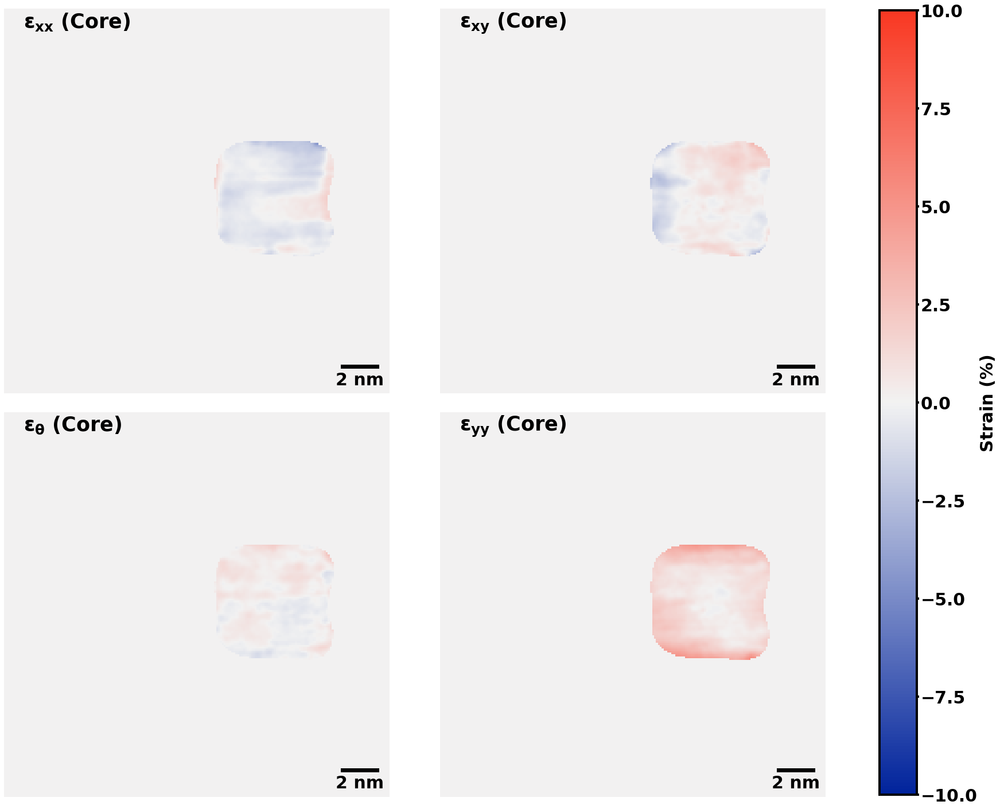

In [157]:
vm = 10
font_size = int(30)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }
ymax = np.amax((np.amax((np.abs(core_vals[:,1]) + core_vals[:,2])),np.amax((np.abs(shell_vals[:,1]) + shell_vals[:,2]))))

fig =plt.figure(figsize=(30,20),constrained_layout=True)

gs = mpgs.GridSpec(2, 2)
ax1 = plt.subplot(gs[0, 0])
ax2 = plt.subplot(gs[0, 1])
ax3 = plt.subplot(gs[1, 0])
ax4 = plt.subplot(gs[1, 1])

im = ax1.imshow(core_ROI*100*e_xx_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax1.add_artist(scalebar)
ax1.annotate(r'$\mathrm{\epsilon_{xx}}$ (Core)', (0.05, 0.95), textcoords='axes fraction', size=35)
ax1.axis('off')


im = ax2.imshow(core_ROI*100*e_xy_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax2.add_artist(scalebar)
ax2.annotate(r'$\mathrm{\epsilon_{xy}}$ (Core)', (0.05, 0.95), textcoords='axes fraction', size=35)
ax2.axis('off')


im = ax3.imshow(core_ROI*100*e_th_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax3.add_artist(scalebar)
ax3.annotate(r'$\mathrm{\epsilon_{\theta}}$ (Core)', (0.05, 0.95), textcoords='axes fraction', size=35)
ax3.axis('off')


im = ax4.imshow(core_ROI*100*e_yy_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax4.add_artist(scalebar)
ax4.annotate(r'$\mathrm{\epsilon_{yy}}$ (Core)', (0.05, 0.95), textcoords='axes fraction', size=35)
ax4.axis('off')

p1 = ax2.get_position().get_points().flatten()
p2 = ax4.get_position().get_points().flatten()
ax_cbar = fig.add_axes([p2[1] + 0.75, p2[1] - 0.1,0.03, 0.95])
cbar = plt.colorbar(im, cax=ax_cbar, orientation='vertical')
cbar.outline.set_linewidth(4)
cbar.set_label('Strain (%)',**sc_font)
ax_cbar.tick_params(width=4)

plt.savefig('Results_4D/Strain_in_Core.pdf',bbox_inches = 'tight')

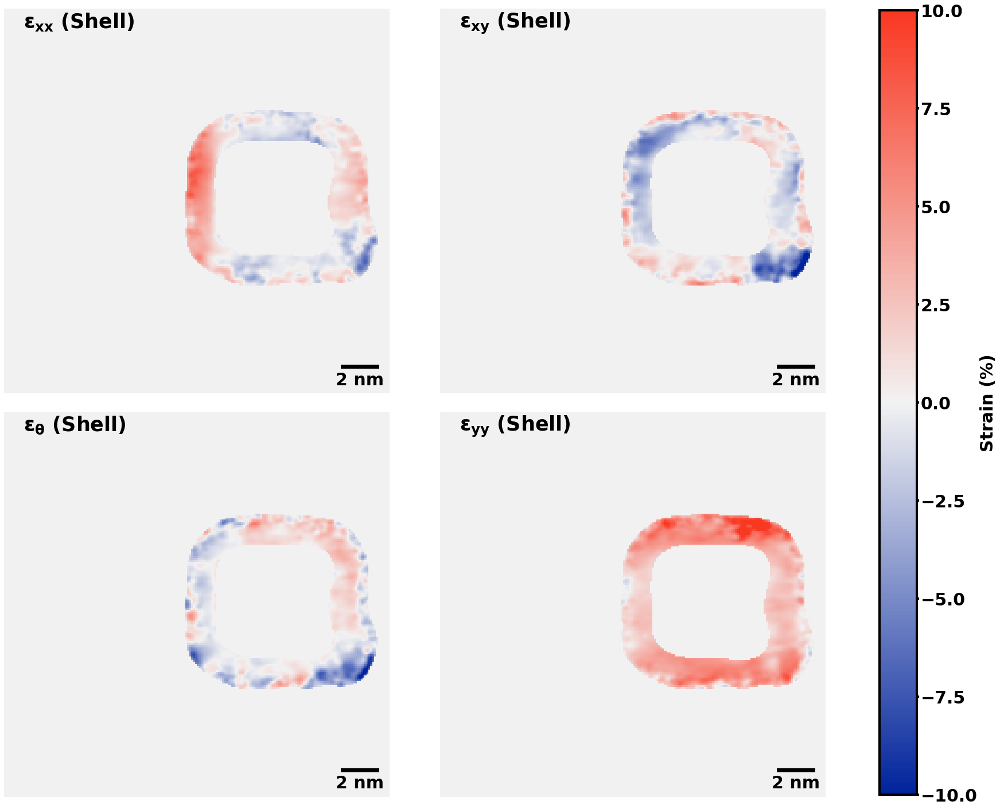

In [158]:
vm = 10
font_size = int(30)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }
ymax = np.amax((np.amax((np.abs(core_vals[:,1]) + core_vals[:,2])),np.amax((np.abs(shell_vals[:,1]) + shell_vals[:,2]))))

fig =plt.figure(figsize=(30,20),constrained_layout=True)

gs = mpgs.GridSpec(2, 2)
ax1 = plt.subplot(gs[0, 0])
ax2 = plt.subplot(gs[0, 1])
ax3 = plt.subplot(gs[1, 0])
ax4 = plt.subplot(gs[1, 1])

im = ax1.imshow(shell_ROI*100*e_xx_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax1.add_artist(scalebar)
ax1.annotate(r'$\mathrm{\epsilon_{xx}}$ (Shell)', (0.05, 0.95), textcoords='axes fraction', size=35)
ax1.axis('off')


im = ax2.imshow(shell_ROI*100*e_xy_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax2.add_artist(scalebar)
ax2.annotate(r'$\mathrm{\epsilon_{xy}}$ (Shell)', (0.05, 0.95), textcoords='axes fraction', size=35)
ax2.axis('off')


im = ax3.imshow(shell_ROI*100*e_th_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax3.add_artist(scalebar)
ax3.annotate(r'$\mathrm{\epsilon_{\theta}}$ (Shell)', (0.05, 0.95), textcoords='axes fraction', size=35)
ax3.axis('off')


im = ax4.imshow(shell_ROI*100*e_yy_ROI,vmin=-vm, vmax=vm,cmap=lin_burd)
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax4.add_artist(scalebar)
ax4.annotate(r'$\mathrm{\epsilon_{yy}}$ (Shell)', (0.05, 0.95), textcoords='axes fraction', size=35)
ax4.axis('off')

p1 = ax2.get_position().get_points().flatten()
p2 = ax4.get_position().get_points().flatten()
ax_cbar = fig.add_axes([p2[1] + 0.75, p2[1] - 0.1,0.03, 0.95])
cbar = plt.colorbar(im, cax=ax_cbar, orientation='vertical')
cbar.outline.set_linewidth(4)
cbar.set_label('Strain (%)',**sc_font)
ax_cbar.tick_params(width=4)

plt.savefig('Results_4D/Strain_in_Shell.pdf',bbox_inches = 'tight')

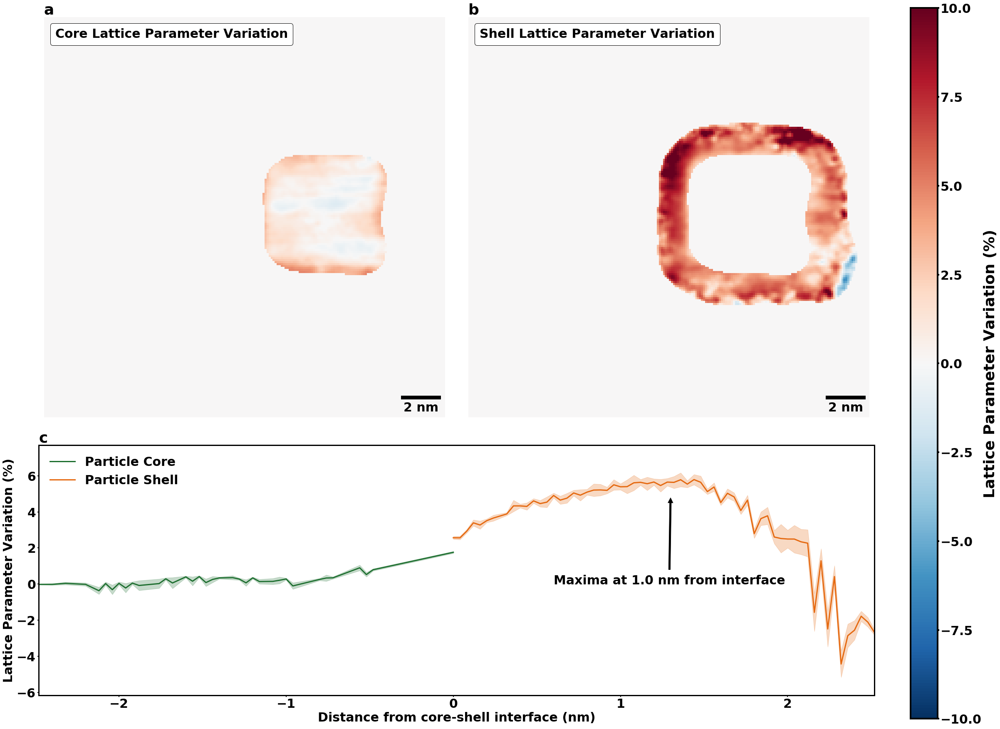

In [176]:
vm = 10

font_size = int(30)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }
max_string = 'Maxima at ' + str(np.round(1*(shell_vals[shell_vals[:,1] == np.amax(shell_vals[:,1]),0][0]))) + ' nm from interface'
fig =plt.figure(figsize=(30,25),constrained_layout=True)

gs = mpgs.GridSpec(2, 2,height_ratios=[2,1.25],width_ratios=[1,1])
ax1 = plt.subplot(gs[0, 0])
ax2 = plt.subplot(gs[0, 1])
ax3 = plt.subplot(gs[1, 0:2])


im = ax1.imshow(100*core_ROI*UC_ratio,vmin=-vm,vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax1.add_artist(scalebar)
at = AnchoredText('Core Lattice Parameter Variation',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax1.add_artist(at)
ax1.set_title(label='a',loc='left',fontdict=title_font)
ax1.axis('off')

im = ax2.imshow(100*shell_ROI*UC_ratio,vmin=-vm,vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax2.add_artist(scalebar)
at = AnchoredText('Shell Lattice Parameter Variation',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax2.add_artist(at)
ax2.set_title(label='b',loc='left',fontdict=title_font)
ax2.axis('off')

ax3.plot(core_vals[:,0],100*core_vals[:,1],c='#1E6F30',linewidth=3,label='Particle Core')
ax3.fill_between(core_vals[:,0], 100*(core_vals[:,1]-core_vals[:,2]), 100*(core_vals[:,1]+core_vals[:,2]),color='#1E6F30',alpha=0.25)
ax3.plot(shell_vals[:,0],100*shell_vals[:,1],c='#E56910',linewidth=3,label='Particle Shell')
ax3.fill_between(shell_vals[:,0], 100*(shell_vals[:,1]-shell_vals[:,2]), 100*(shell_vals[:,1]+shell_vals[:,2]),color='#E56910',alpha=0.25)
for axis in ['top','bottom','left','right']:
    ax3.spines[axis].set_linewidth(3)
ax3.tick_params(width=2)
ax3.legend(loc='upper left',frameon=False)
ax3.set_xlim(np.amin(core_vals[:,0]),np.amax(shell_vals[:,0]))
ax3.set_ylim(-100*ymax,125*ymax)
ax3.set_xlabel('Distance from core-shell interface (nm)',**sc_font)
ax3.set_ylabel('Lattice Parameter Variation (%)',**sc_font)
ax3.set_title(label='c',loc='left',fontdict=title_font)
ax3.annotate(max_string, xy=(1.3, 5), xytext=(0.6, 0),
            arrowprops=dict(facecolor='Black', shrink=0.05))

p1 = ax2.get_position().get_points().flatten()
p2 = ax3.get_position().get_points().flatten()
ax_cbar = fig.add_axes([p2[1] + 0.9, p2[1] - 0.1,0.03, 0.95])
cbar = plt.colorbar(im, cax=ax_cbar, orientation='vertical')
cbar.outline.set_linewidth(4)
cbar.set_label('Lattice Parameter Variation (%)',**title_font)
ax_cbar.tick_params(width=4)

plt.savefig('Results_4D/Core_Shell_UnitCellSize.pdf',bbox_inches = 'tight')

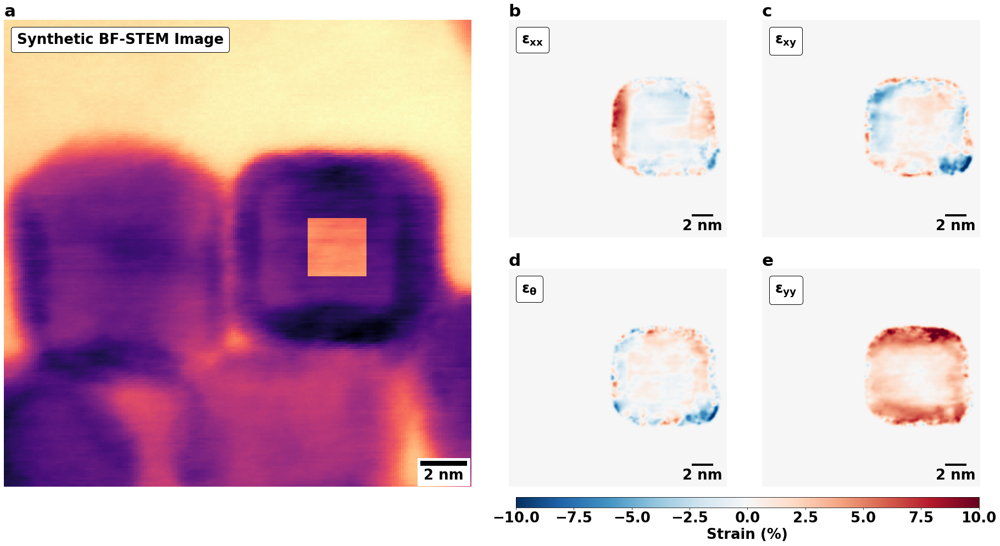

In [199]:
#vm = np.amax(np.abs(np.concatenate((e_xx_ROI,e_xy_ROI,e_th_ROI,e_yy_ROI),axis=1)))
vm = 10
font_size = int(26)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

fig =plt.figure(figsize=(26,13))

gs = mpgs.GridSpec(2, 4)
ax1 = plt.subplot(gs[:, 0:2])
ax2 = plt.subplot(gs[0, 2])
ax3 = plt.subplot(gs[0, 3])
ax4 = plt.subplot(gs[1, 2])
ax5 = plt.subplot(gs[1, 3])

ax1.imshow((0.5*Reference_Region)+st.util.image_normalizer(bf_stem),cmap='magma')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax1.axis('off')
at = AnchoredText('Synthetic BF-STEM Image',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax1.add_artist(at)
ax1.set_title(label='a',loc='left',fontdict=title_font)
ax1.add_artist(scalebar)

im = ax2.imshow(100*e_xx_ROI,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax2.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xx}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax2.add_artist(at)
ax2.set_title(label='b',loc='left',fontdict=title_font)
ax2.axis('off')


im = ax3.imshow(100*e_xy_ROI,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax3.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{xy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax3.add_artist(at)
ax3.set_title(label='c',loc='left',fontdict=title_font)
ax3.axis('off')


im = ax4.imshow(100*e_th_ROI,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax4.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{\theta}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax4.add_artist(at)
ax4.set_title(label='d',loc='left',fontdict=title_font)
ax4.axis('off')


im = ax5.imshow(100*e_yy_ROI,vmin=-vm, vmax=vm,cmap='RdBu_r')
scalebar = ScaleBar(scan_calib_vals,scan_calib_unit)
scalebar.location = 'lower right'
scalebar.box_alpha = 0
scalebar.color = 'k'
ax5.add_artist(scalebar)
at = AnchoredText(r'$\mathrm{\epsilon_{yy}}$',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax5.add_artist(at)
ax5.set_title(label='e',loc='left',fontdict=title_font)
ax5.axis('off')

p4 = ax4.get_position().get_points().flatten()
p5 = ax5.get_position().get_points().flatten()

ax_cbar = fig.add_axes([p4[0] - 0.005, -0.01, 0.5*p5[2], 0.02])
cbar = plt.colorbar(im, cax=ax_cbar, orientation='horizontal')
cbar.set_label('Strain (%)',**sc_font)

plt.tight_layout()
plt.savefig('Results_4D/Strain_in_Particle1.pdf',bbox_inches = 'tight')

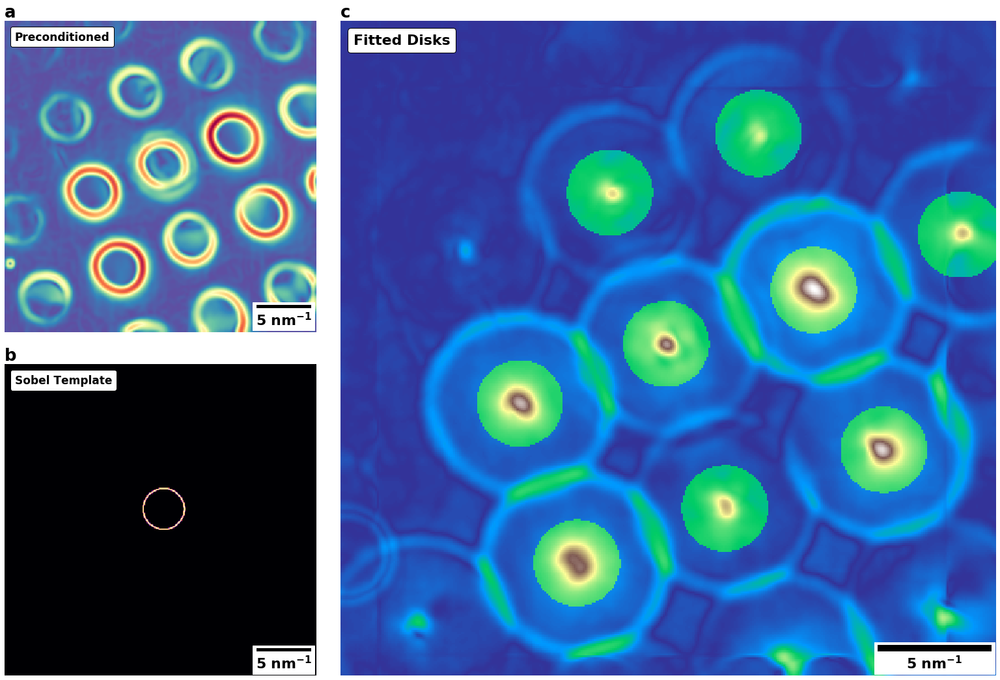

In [183]:
overlaid_circles = np.zeros_like(lsc_reference)
for ii in range(9):
    overlaid_circles += st.util.make_circle(lsc_reference.shape,reference_disk_list[ii,0],reference_disk_list[ii,1],beam_r)
    
font_size = int(22)
sc_font={'weight' : 'bold',
         'size'   : font_size}
mpl.rc('font', **sc_font)
title_font = {'weight': 'bold',
              'size': int(1.2*font_size),
             }

fig =plt.figure(figsize=(22,15))

gs = mpgs.GridSpec(2, 3)
ax1 = plt.subplot(gs[0, 0])
ax2 = plt.subplot(gs[1, 0])
ax3 = plt.subplot(gs[:, 1:3])

ax1.imshow(sobel_lm_cbed,cmap='Spectral_r')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax1.axis('off')
at = AnchoredText('Preconditioned',
                  prop=dict(size=int(0.8*font_size)), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax1.add_artist(at)
ax1.set_title(label='a',loc='left',fontdict=title_font)
ax1.add_artist(scalebar)

im = ax2.imshow(sobel_center_disk,cmap='magma')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax2.add_artist(scalebar)
at = AnchoredText('Sobel Template',
                  prop=dict(size=int(0.8*font_size)), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax2.add_artist(at)
ax2.set_title(label='b',loc='left',fontdict=title_font)
ax2.axis('off')


im = ax3.imshow(st.util.image_normalizer(lsc_reference)+(0.25*overlaid_circles),cmap='terrain')
scalebar = ScaleBar(inverse_nm_calibration, '1/nm', SI_LENGTH_RECIPROCAL)
scalebar.location = 'lower right'
scalebar.box_alpha = 1
scalebar.color = 'k'
ax3.add_artist(scalebar)
at = AnchoredText('Fitted Disks',
                  prop=dict(size=font_size), frameon=True,
                  loc='upper left',
                  )
at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax3.add_artist(at)
ax3.set_title(label='c',loc='left',fontdict=title_font)
ax3.axis('off')

plt.tight_layout()
plt.savefig('Results_4D/Particle1_fitted_disks.pdf',bbox_inches = 'tight')

In [198]:
whos

Variable                 Type                          Data/Info
----------------------------------------------------------------
AnchoredText             type                          <class 'matplotlib.offsetbox.AnchoredText'>
Core_UC                  ndarray                       3371: 3371 elems, type `float64`, 26968 bytes
Core_dist                ndarray                       3371: 3371 elems, type `float64`, 26968 bytes
LSC                      type                          <class 'matplotlib.colors<...>LinearSegmentedColormap'>
Mean_CBED                ndarray                       360x360: 129600 elems, type `float64`, 1036800 bytes (1012.5 kb)
Mean_CBED_Reference      ndarray                       360x360: 129600 elems, type `float64`, 1036800 bytes (1012.5 kb)
NamespaceMagics          MetaHasTraits                 <class 'IPython.core.magi<...>mespace.NamespaceMagics'>
ROI_4D                   ndarray                       360x360x7939: 1028894400 elems, type `float32`, 4115

In [195]:
np.savez_compressed('Particle1_4D.npz',
                    total_ROI=total_ROI,
                    core_ROI = core_ROI,
                    shell_ROI = shell_ROI,
                    e_th_ROI=e_th_ROI,
                    e_xx_ROI=e_xx_ROI,
                    e_xy_ROI=e_xy_ROI,
                    e_yy_ROI=e_yy_ROI,
                    fit_data=fit_data,
                    conc_profiles_lsb=conc_profiles_lsb,
                    mcrar_lsb=mcrar_lsb,
                    spec_profiles_lsb=spec_profiles_lsb,
                    conc_profiles_log=conc_profiles_log,
                    mcrar_log=mcrar_log,
                    spec_profiles_log=spec_profiles_log,
                    conc_profiles=conc_profiles,
                    mcrar=mcrar,
                    spec_profiles=spec_profiles,
                    scan_calib_unit=scan_calib_unit,
                    scan_calib_vals=scan_calib_vals,
                    mrad_calibration=mrad_calibration)